In [1]:
from datasets import (
    create_train_dataset_multi, create_valid_dataset_multi, create_train_loader, create_valid_loader,
)
from models_multiview.create_multiview_model import create_model
from torch_utils import utils
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from pprint import pprint
from tqdm import tqdm
from utils import transforms as T
import torch
import argparse
import yaml
import torchvision
import torchvision.transforms.functional as F
import time
import numpy as np
from torch_utils import froc
import matplotlib.pyplot as plt
import cv2
torch.multiprocessing.set_sharing_strategy('file_system')
from typing import Dict, List, Optional, Tuple, Union

/home/vishc1/anaconda3/envs/hoang/lib/python3.9/site-packages/requests/__init__.py:109: RequestsDependencyWarning: urllib3 (1.26.14) or chardet (None)/charset_normalizer (3.1.0) doesn't match a supported version!
  warnings.warn(


In [2]:
data_configs= {
    'TRAIN_DIR_IMAGES' : '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/images/',
    'TRAIN_DIR_LABELS' : '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/',
    'VALID_DIR_IMAGES' : '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/images/',
    'VALID_DIR_LABELS' : '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/',
# Class names.
    'CLASSES' :[
    '__background__',
    'Mass',
    'Suspicious Calcification', 
    'Asymmetry',
    'Focal Asymmetry', 
    'Architectural Distortion',
    'Other'

],

# Number of classes (object classes + 1 for background class in Faster RCNN).
    'NC' : 7,

# Whether to save the predictions of the validation set while training.
    'SAVE_VALID_PREDICTION_IMAGES' : True,
}
data_configs

{'TRAIN_DIR_IMAGES': '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/images/',
 'TRAIN_DIR_LABELS': '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/',
 'VALID_DIR_IMAGES': '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/images/',
 'VALID_DIR_LABELS': '../VinDr_Mammo/physionet.org/files/vindr-mammo/1.0.0/',
 'CLASSES': ['__background__',
  'Mass',
  'Suspicious Calcification',
  'Asymmetry',
  'Focal Asymmetry',
  'Architectural Distortion',
  'Other'],
 'NC': 7,
 'SAVE_VALID_PREDICTION_IMAGES': True}

In [3]:
args={
    'model' : 'multiview_detector',
    'weights' : 'outputs/training/multi_resnet50_allview_crop_small_fix/last_model.pth',
    'batch' : 1,
    'workers': 4,
    'device' : 'cuda:0',
    'imgsz' : (500, 1200),
    
}

In [4]:
try: # Use test images if present.
    VALID_DIR_IMAGES = data_configs['TEST_DIR_IMAGES']
    VALID_DIR_LABELS = data_configs['TEST_DIR_LABELS']
except: # Else use the validation images.
    VALID_DIR_IMAGES = data_configs['VALID_DIR_IMAGES']
    VALID_DIR_LABELS = data_configs['VALID_DIR_LABELS']
NUM_CLASSES = data_configs['NC']
CLASSES = data_configs['CLASSES']
NUM_WORKERS = args['workers']
DEVICE = args['device']
BATCH_SIZE = args['batch']

# Model configurations
IMAGE_SIZE = args['imgsz']

# Load the pretrained model
create_model1 = create_model[args['model']]
if args['weights'] is None:
    model = create_model1(num_classes=NUM_CLASSES, norm = None,size= IMAGE_SIZE, coco_model=False)


# Load weights.
if args['weights'] is not None:
    model = create_model1(num_classes=NUM_CLASSES, norm = None,size= IMAGE_SIZE, coco_model=False)
    checkpoint = torch.load(args['weights'], map_location=DEVICE)
    model.load_state_dict(checkpoint['model_state_dict'])
    train_dataset = create_train_dataset_multi(
        VALID_DIR_IMAGES, 
        VALID_DIR_LABELS, 
        IMAGE_SIZE, 
        CLASSES,
    )
model.to(DEVICE).eval()

train_loader = create_train_loader(train_dataset, BATCH_SIZE, NUM_WORKERS)




ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): FrozenBatchNorm2d(64, eps=1e-05)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): FrozenBatchNorm2d(64, eps=1e-05)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): FrozenBatchNorm2d(256, eps=1e-05)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(256, eps=1e-05)
      )
    )
    (1): Bottleneck(
      (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1):

737
      index                          study_id  \
0         0  48575a27b7c992427041a82fa750d3fa   
1         1  48575a27b7c992427041a82fa750d3fa   
2         2  75e8e48933289d70b407379a564f8594   
3         3  75e8e48933289d70b407379a564f8594   
4         4  c3487424fee1bdd4515b72dc3fd69813   
...     ...                               ...   
1797   2241  7c98228fc11204260460934ba8c6e12b   
1798   2242  7c98228fc11204260460934ba8c6e12b   
1799   2243  7c98228fc11204260460934ba8c6e12b   
1800   2252  0bfd4fcebaba4e9c4086edd05044a75f   
1801   2253  0bfd4fcebaba4e9c4086edd05044a75f   

                              image_id  height  width         xmin  \
0     4e3a578fe535ea4f5258d3f7f4419db8    3518   2800  2355.139893   
1     dac39351b0f3a8c670b7f8dc88029364    3518   2800  2386.679932   
2     c83f780904f25eacb44e9030f32c66e1    3518   2800  2279.179932   
3     893528bc38a0362928a89364f1b692fd    3518   2800  1954.270020   
4     318264c881bf12f2c1efe5f93920cc37    3518   2800  21

In [5]:
invTrans = T.Normalize(
                mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
                std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
            )

  0%|▏                                                                                                                                                                                                                                                                                 | 1/1474 [00:04<1:42:52,  4.19s/it]

(1216, 512, 3)


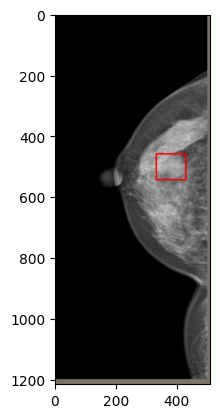

(1216, 512, 3)


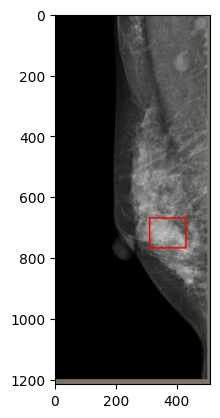

  0%|▎                                                                                                                                                                                                                                                                                   | 2/1474 [00:04<48:20,  1.97s/it]

(1216, 512, 3)


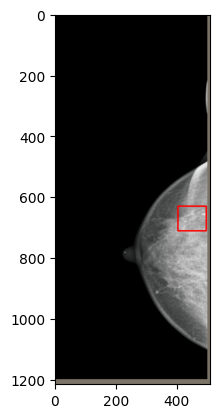

(1216, 512, 3)


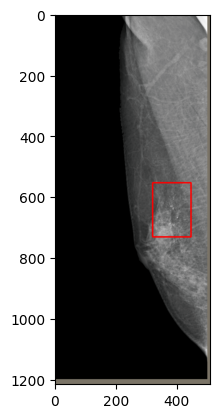

  0%|▋                                                                                                                                                                                                                                                                                   | 4/1474 [00:05<21:49,  1.12it/s]

(1216, 512, 3)


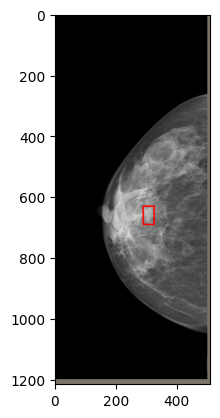

(1216, 512, 3)


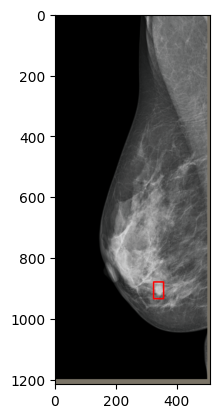

  0%|█                                                                                                                                                                                                                                                                                   | 6/1474 [00:05<14:46,  1.66it/s]

(1216, 512, 3)


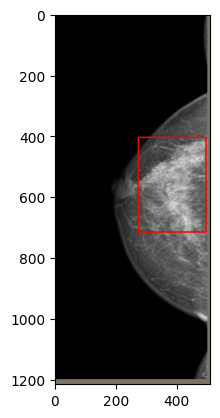

(1216, 512, 3)


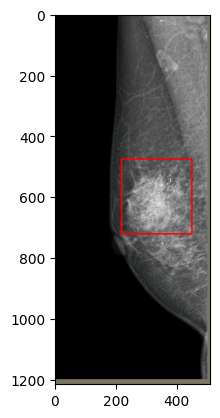

  1%|█▋                                                                                                                                                                                                                                                                                  | 9/1474 [00:06<08:56,  2.73it/s]

(1216, 512, 3)


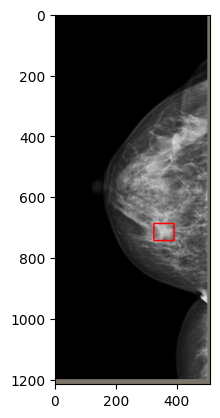

(1216, 512, 3)


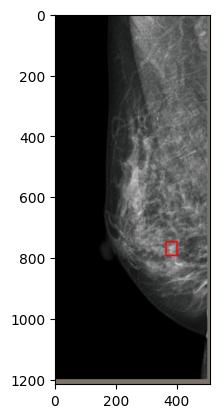

  1%|█▊                                                                                                                                                                                                                                                                                 | 10/1474 [00:06<09:14,  2.64it/s]

(1216, 512, 3)


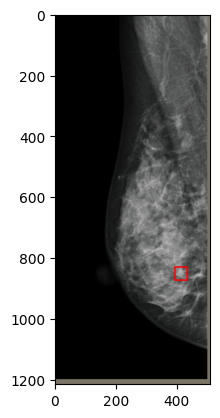

  1%|██▍                                                                                                                                                                                                                                                                                | 13/1474 [00:07<05:57,  4.08it/s]

(1216, 512, 3)


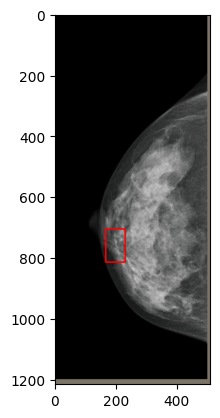

(1216, 512, 3)


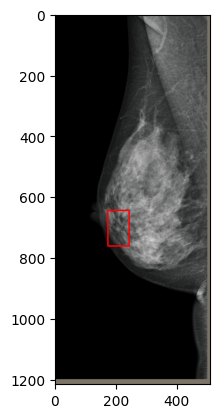

  1%|██▊                                                                                                                                                                                                                                                                                | 15/1474 [00:07<06:02,  4.03it/s]

(1216, 512, 3)


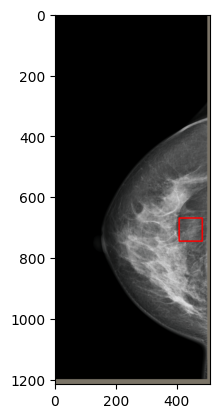

(1216, 512, 3)


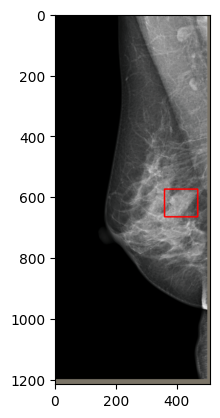

  1%|██▉                                                                                                                                                                                                                                                                                | 16/1474 [00:08<07:16,  3.34it/s]

(1216, 512, 3)


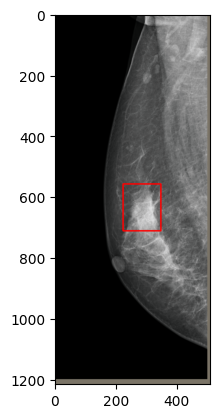

  1%|███▎                                                                                                                                                                                                                                                                               | 18/1474 [00:08<06:05,  3.98it/s]

(1216, 512, 3)


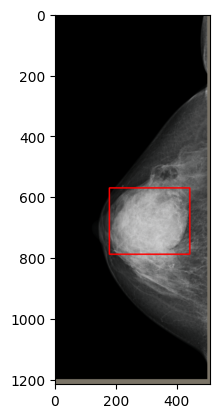

(1216, 512, 3)


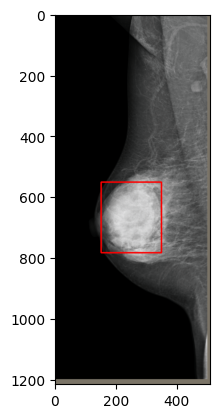

  1%|███▋                                                                                                                                                                                                                                                                               | 20/1474 [00:09<06:16,  3.86it/s]

(1216, 512, 3)


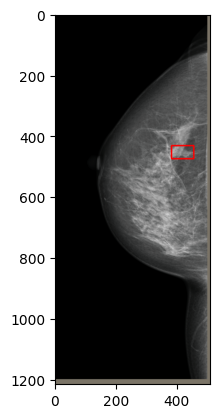

  1%|████                                                                                                                                                                                                                                                                               | 22/1474 [00:09<05:37,  4.30it/s]

(1216, 512, 3)


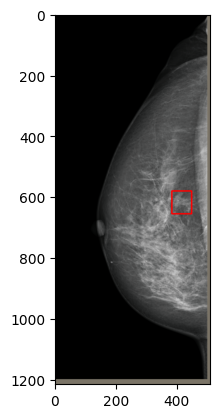

(1216, 512, 3)


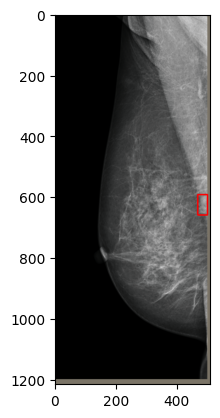

  2%|████▍                                                                                                                                                                                                                                                                              | 24/1474 [00:10<05:52,  4.12it/s]

(1216, 512, 3)


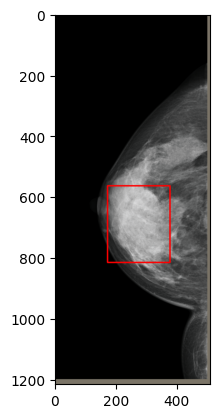

(1216, 512, 3)


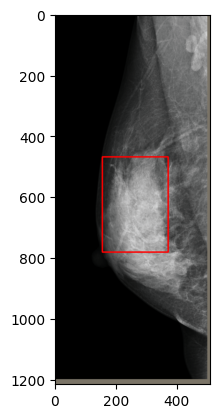

  2%|████▊                                                                                                                                                                                                                                                                              | 26/1474 [00:10<05:59,  4.03it/s]

(1216, 512, 3)


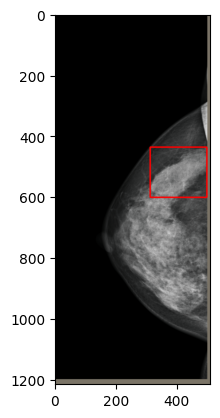

(1216, 512, 3)


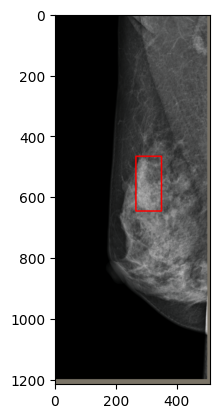

  2%|█████                                                                                                                                                                                                                                                                              | 27/1474 [00:11<07:18,  3.30it/s]

(1216, 512, 3)


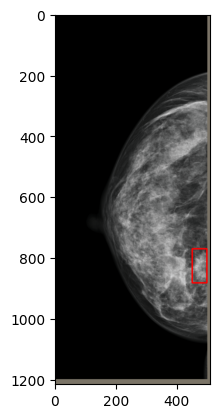

(1216, 512, 3)


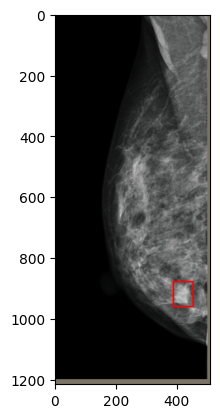

  2%|█████▊                                                                                                                                                                                                                                                                             | 31/1474 [00:11<05:19,  4.51it/s]

(1216, 512, 3)


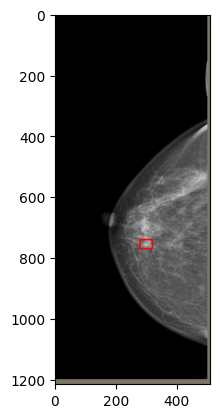

(1216, 512, 3)


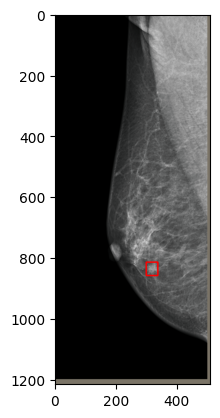

  2%|█████▉                                                                                                                                                                                                                                                                             | 32/1474 [00:12<06:01,  3.98it/s]

(1216, 512, 3)


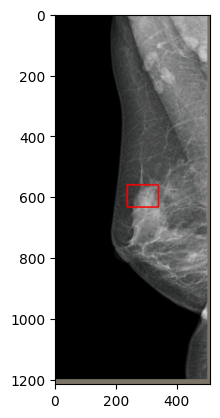

  2%|██████▌                                                                                                                                                                                                                                                                            | 35/1474 [00:12<06:02,  3.96it/s]

(1216, 512, 3)


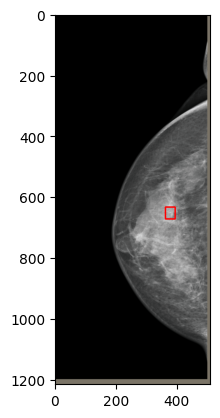

(1216, 512, 3)


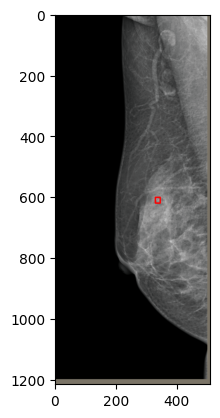

  2%|██████▋                                                                                                                                                                                                                                                                            | 36/1474 [00:13<07:10,  3.34it/s]

(1216, 512, 3)


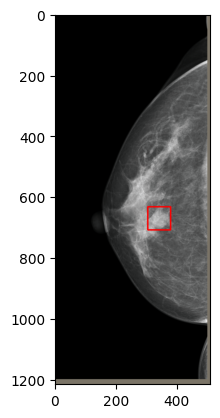

(1216, 512, 3)


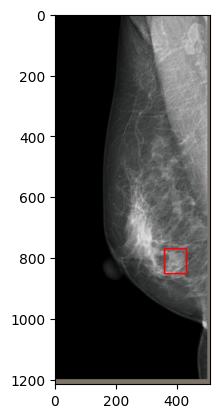

  3%|███████▎                                                                                                                                                                                                                                                                           | 39/1474 [00:14<08:15,  2.89it/s]

(1216, 512, 3)


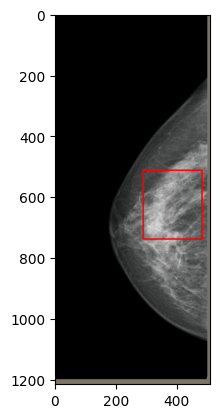

(1216, 512, 3)


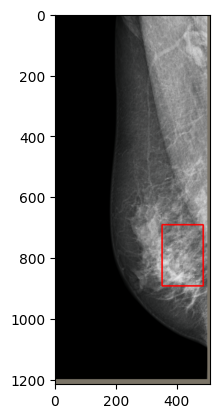

  3%|███████▍                                                                                                                                                                                                                                                                           | 40/1474 [00:15<12:33,  1.90it/s]

(1216, 512, 3)


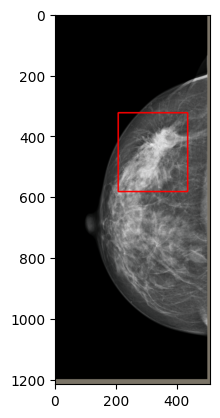

(1216, 512, 3)


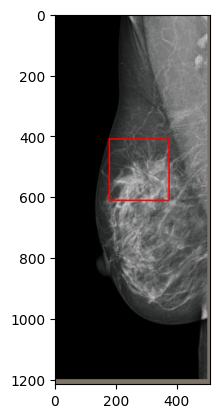

  3%|████████                                                                                                                                                                                                                                                                           | 43/1474 [00:16<10:49,  2.20it/s]

(1216, 512, 3)


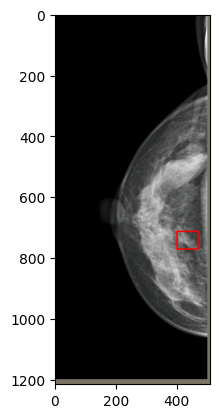

(1216, 512, 3)


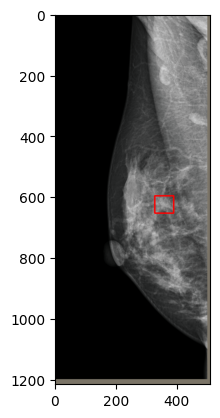

  3%|████████▍                                                                                                                                                                                                                                                                          | 45/1474 [00:17<08:19,  2.86it/s]

(1216, 512, 3)


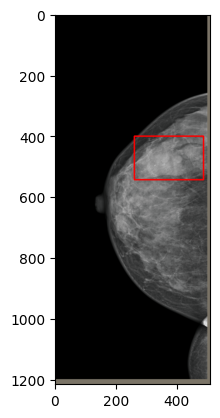

(1216, 512, 3)


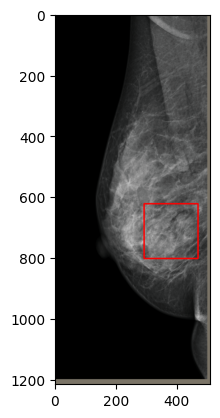

  3%|████████▌                                                                                                                                                                                                                                                                          | 46/1474 [00:17<08:30,  2.80it/s]

(1216, 512, 3)


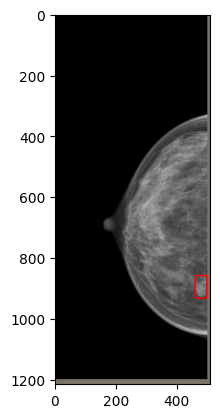

  3%|█████████▏                                                                                                                                                                                                                                                                         | 49/1474 [00:19<10:07,  2.34it/s]

(1216, 512, 3)


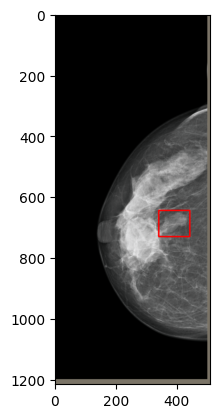

(1216, 512, 3)


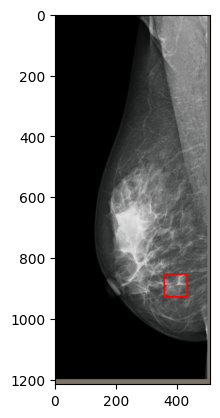

  3%|█████████▌                                                                                                                                                                                                                                                                         | 51/1474 [00:20<11:41,  2.03it/s]

(1216, 512, 3)


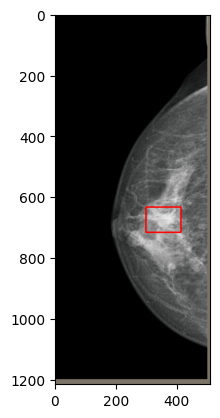

(1216, 512, 3)


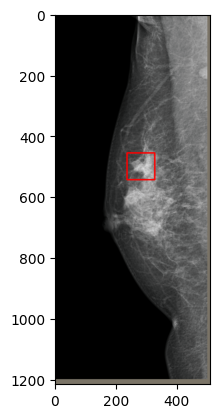

  4%|█████████▋                                                                                                                                                                                                                                                                         | 52/1474 [00:20<11:06,  2.13it/s]

(1216, 512, 3)


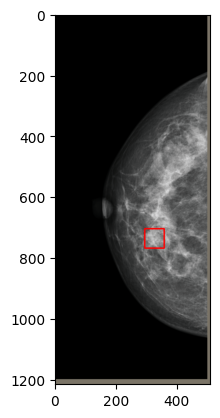

(1216, 512, 3)


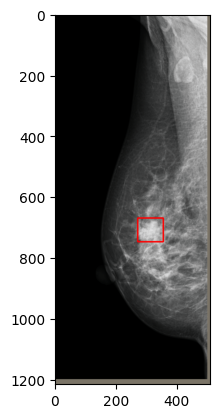

  4%|██████████                                                                                                                                                                                                                                                                         | 54/1474 [00:21<08:47,  2.69it/s]

(1216, 512, 3)


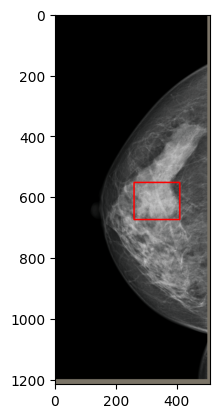

(1216, 512, 3)


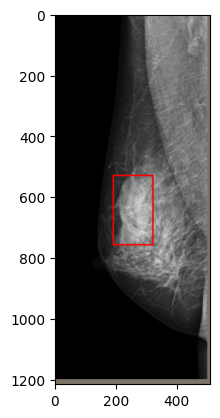

  4%|██████████▋                                                                                                                                                                                                                                                                        | 57/1474 [00:22<09:08,  2.58it/s]

(1216, 512, 3)


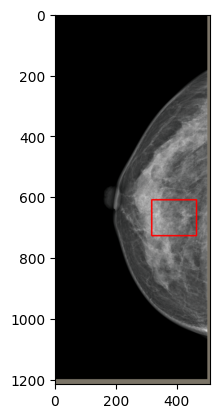

(1216, 512, 3)


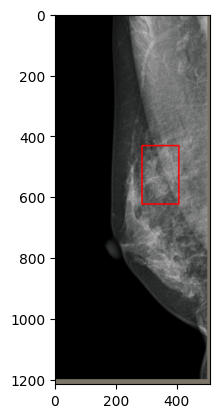

  4%|██████████▊                                                                                                                                                                                                                                                                        | 58/1474 [00:23<09:06,  2.59it/s]

(1216, 512, 3)


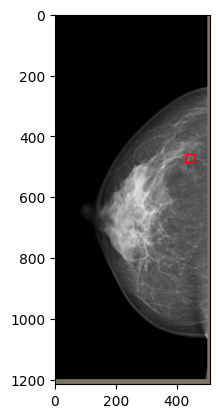

(1216, 512, 3)


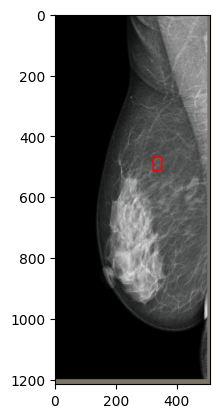

  4%|███████████▍                                                                                                                                                                                                                                                                       | 61/1474 [00:24<08:03,  2.92it/s]

(1216, 512, 3)


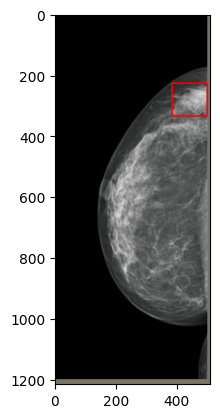

(1216, 512, 3)


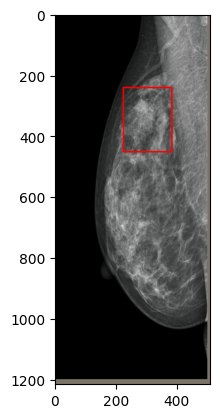

  4%|███████████▌                                                                                                                                                                                                                                                                       | 62/1474 [00:24<09:13,  2.55it/s]

(1216, 512, 3)


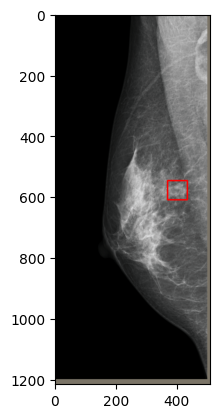

  4%|███████████▊                                                                                                                                                                                                                                                                       | 63/1474 [00:25<10:33,  2.23it/s]

(1216, 512, 3)


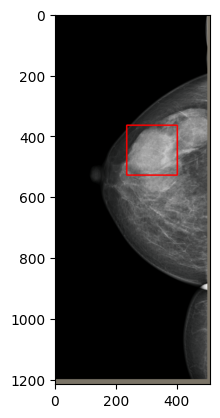

(1216, 512, 3)


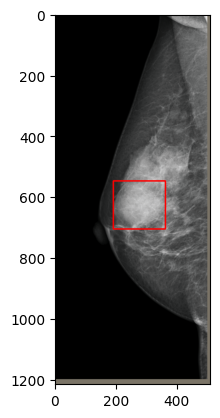

  4%|████████████▎                                                                                                                                                                                                                                                                      | 66/1474 [00:25<07:04,  3.32it/s]

(1216, 512, 3)


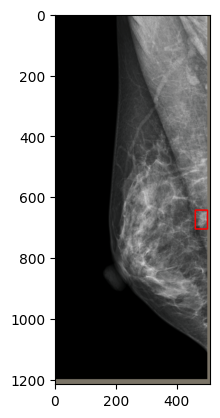

  5%|████████████▊                                                                                                                                                                                                                                                                      | 69/1474 [00:27<08:27,  2.77it/s]

(1216, 512, 3)


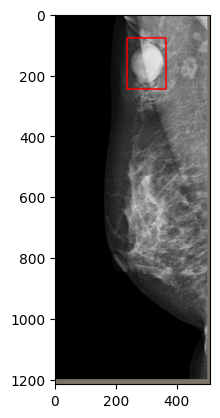

  5%|█████████████                                                                                                                                                                                                                                                                      | 70/1474 [00:27<09:34,  2.44it/s]

(1216, 512, 3)


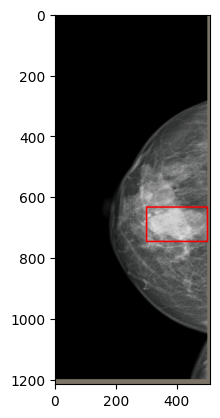

(1216, 512, 3)


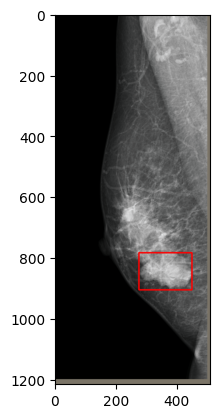

  5%|█████████████▌                                                                                                                                                                                                                                                                     | 73/1474 [00:29<09:42,  2.40it/s]

(1216, 512, 3)


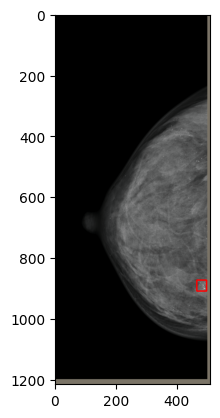

(1216, 512, 3)


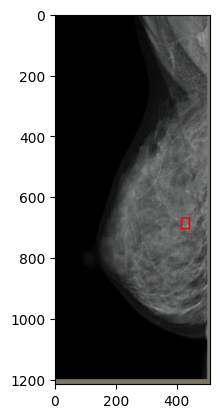

  5%|█████████████▊                                                                                                                                                                                                                                                                     | 74/1474 [00:30<12:34,  1.86it/s]

(1216, 512, 3)


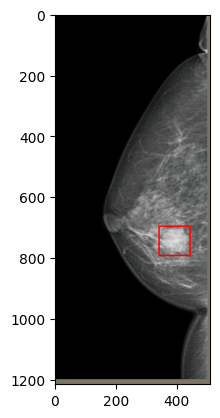

(1216, 512, 3)


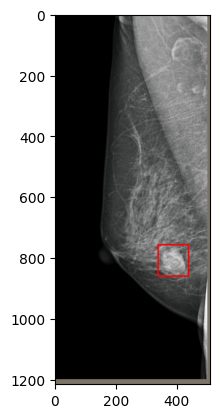

  5%|██████████████▏                                                                                                                                                                                                                                                                    | 76/1474 [00:31<13:33,  1.72it/s]

(1216, 512, 3)


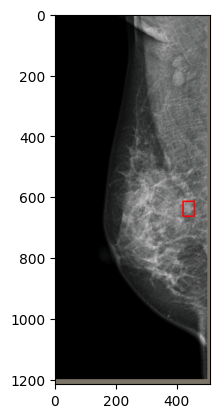

  5%|██████████████▌                                                                                                                                                                                                                                                                    | 78/1474 [00:31<09:14,  2.52it/s]

(1216, 512, 3)


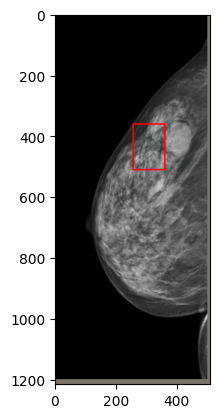

(1216, 512, 3)


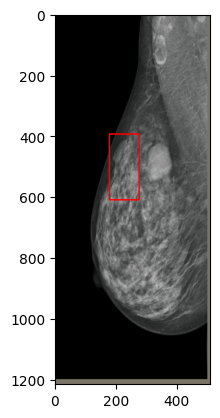

  5%|██████████████▋                                                                                                                                                                                                                                                                    | 79/1474 [00:33<13:43,  1.69it/s]

(1216, 512, 3)


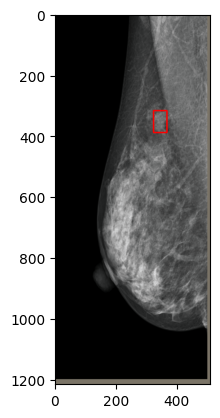

  6%|███████████████▎                                                                                                                                                                                                                                                                   | 82/1474 [00:33<10:15,  2.26it/s]

(1216, 512, 3)


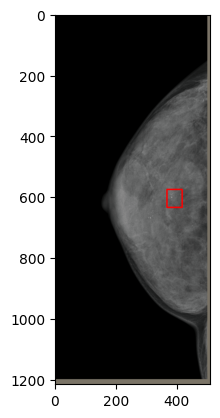

(1216, 512, 3)


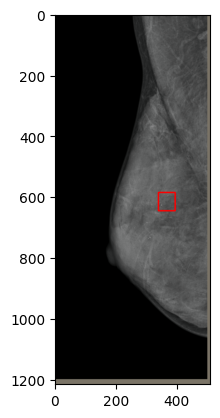

  6%|███████████████▋                                                                                                                                                                                                                                                                   | 84/1474 [00:35<11:04,  2.09it/s]

(1216, 512, 3)


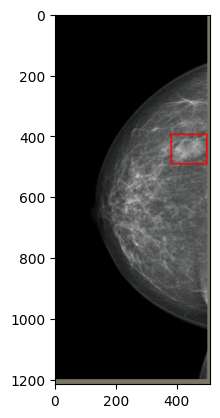

(1216, 512, 3)


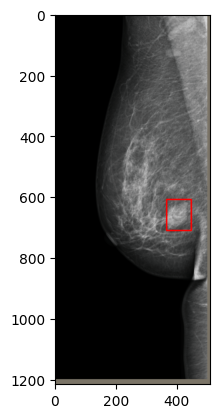

  6%|████████████████                                                                                                                                                                                                                                                                   | 86/1474 [00:35<09:53,  2.34it/s]

(1216, 512, 3)


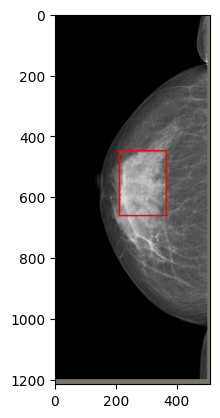

(1216, 512, 3)


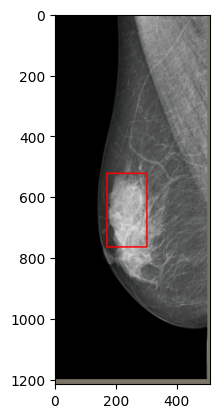

  6%|████████████████▌                                                                                                                                                                                                                                                                  | 89/1474 [00:37<09:46,  2.36it/s]

(1216, 512, 3)


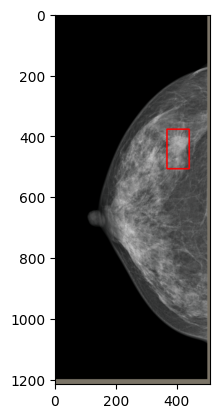

(1216, 512, 3)


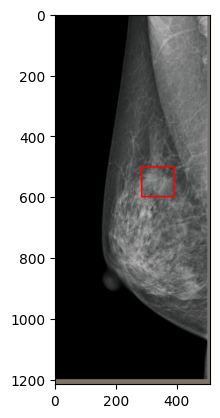

  6%|████████████████▊                                                                                                                                                                                                                                                                  | 90/1474 [00:39<17:13,  1.34it/s]

(1216, 512, 3)


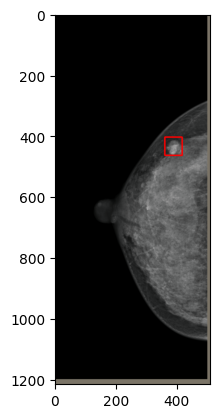

(1216, 512, 3)


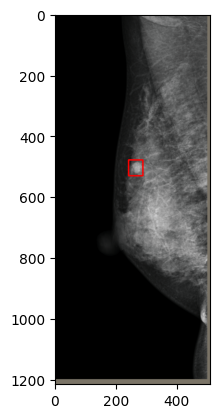

  6%|█████████████████▏                                                                                                                                                                                                                                                                 | 92/1474 [00:40<18:37,  1.24it/s]

(1216, 512, 3)


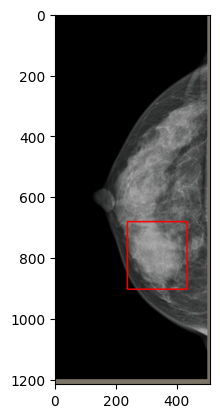

(1216, 512, 3)


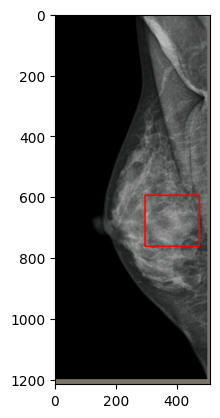

  6%|█████████████████▌                                                                                                                                                                                                                                                                 | 94/1474 [00:41<13:46,  1.67it/s]

(1216, 512, 3)


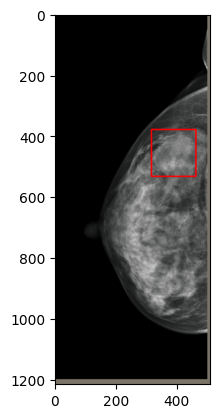

(1216, 512, 3)


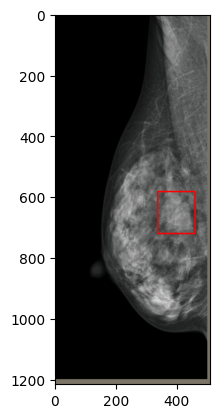

  7%|█████████████████▉                                                                                                                                                                                                                                                                 | 96/1474 [00:42<13:42,  1.68it/s]

(1216, 512, 3)


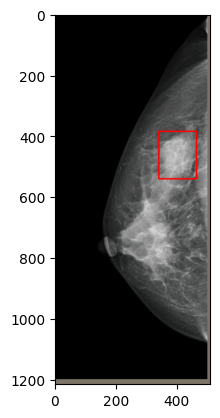

(1216, 512, 3)


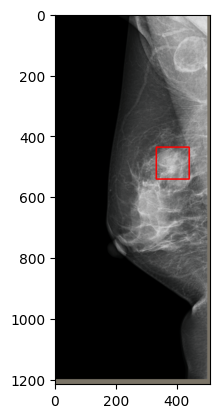

  7%|██████████████████▎                                                                                                                                                                                                                                                                | 98/1474 [00:43<10:14,  2.24it/s]

(1216, 512, 3)


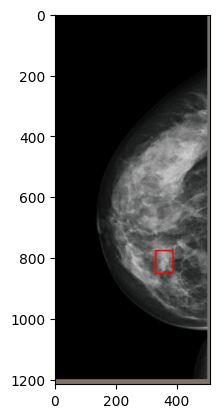

  7%|██████████████████▌                                                                                                                                                                                                                                                               | 100/1474 [00:44<11:41,  1.96it/s]

(1216, 512, 3)


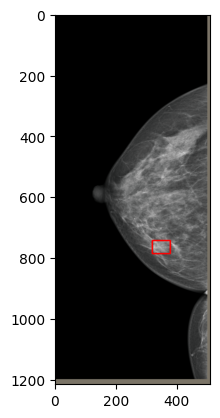

(1216, 512, 3)


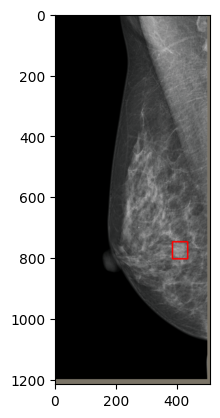

  7%|██████████████████▉                                                                                                                                                                                                                                                               | 102/1474 [00:44<08:54,  2.57it/s]

(1216, 512, 3)


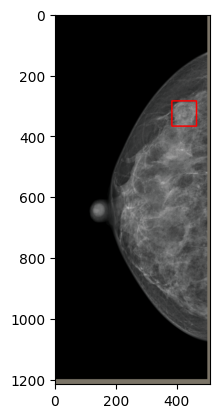

(1216, 512, 3)


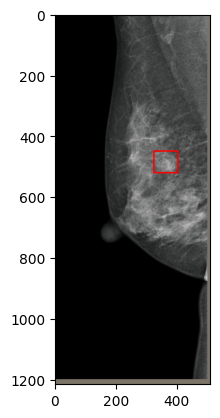

  7%|███████████████████▎                                                                                                                                                                                                                                                              | 104/1474 [00:46<12:47,  1.78it/s]

(1216, 512, 3)


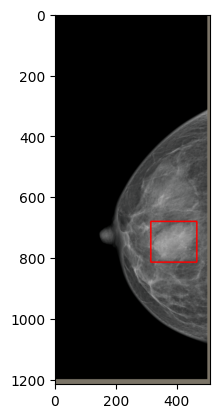

(1216, 512, 3)


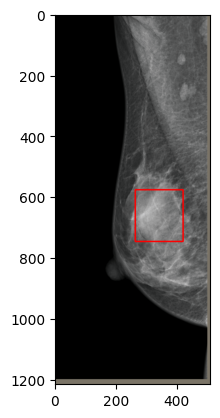

  7%|███████████████████▋                                                                                                                                                                                                                                                              | 106/1474 [00:47<12:16,  1.86it/s]

(1216, 512, 3)


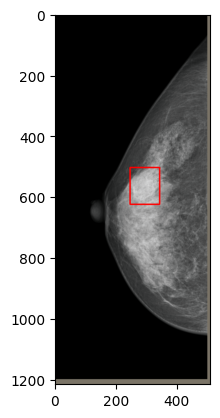

(1216, 512, 3)


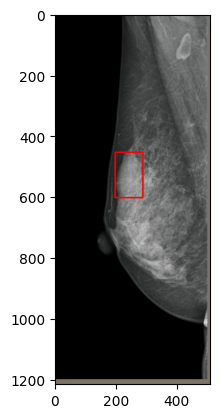

  7%|████████████████████                                                                                                                                                                                                                                                              | 108/1474 [00:48<13:12,  1.72it/s]

(1216, 512, 3)


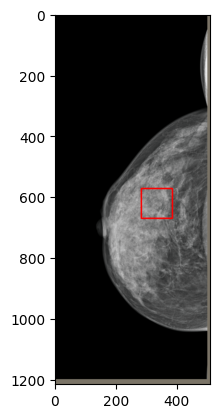

(1216, 512, 3)


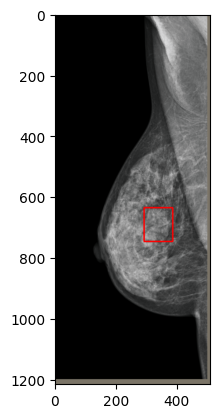

  7%|████████████████████▍                                                                                                                                                                                                                                                             | 110/1474 [00:49<11:29,  1.98it/s]

(1216, 512, 3)


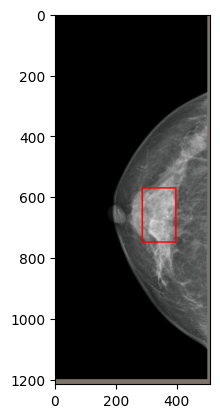

(1216, 512, 3)


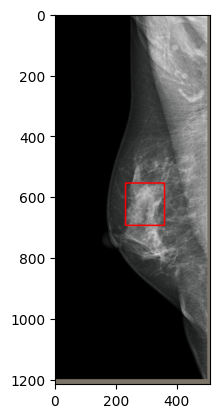

  8%|████████████████████▊                                                                                                                                                                                                                                                             | 112/1474 [00:50<13:31,  1.68it/s]

(1216, 512, 3)


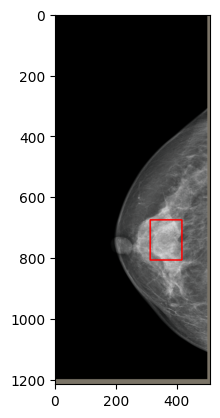

(1216, 512, 3)


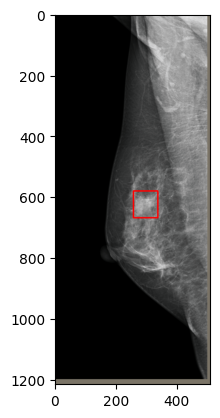

  8%|█████████████████████▏                                                                                                                                                                                                                                                            | 114/1474 [00:51<12:04,  1.88it/s]

(1216, 512, 3)


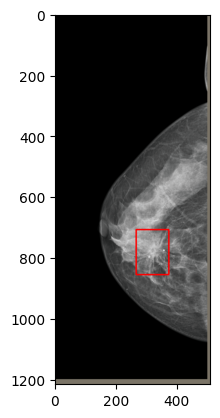

(1216, 512, 3)


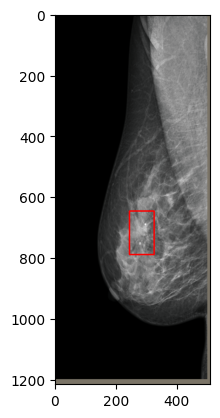

  8%|█████████████████████▌                                                                                                                                                                                                                                                            | 116/1474 [00:52<12:11,  1.86it/s]

(1216, 512, 3)


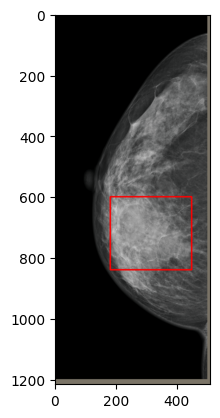

(1216, 512, 3)


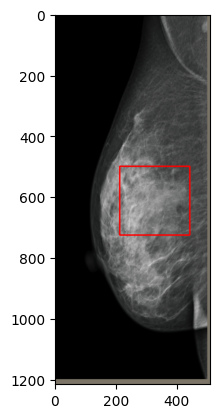

  8%|█████████████████████▉                                                                                                                                                                                                                                                            | 118/1474 [00:53<10:35,  2.13it/s]

(1216, 512, 3)


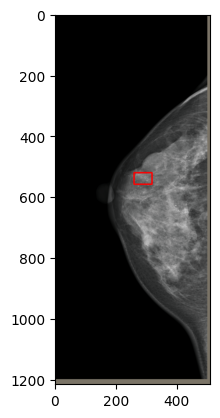

(1216, 512, 3)


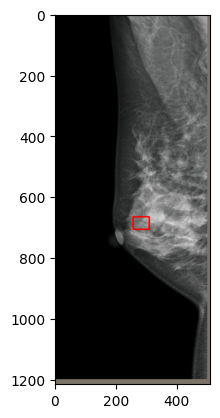

  8%|██████████████████████▎                                                                                                                                                                                                                                                           | 120/1474 [00:54<09:28,  2.38it/s]

(1216, 512, 3)


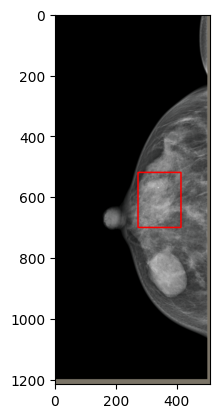

(1216, 512, 3)


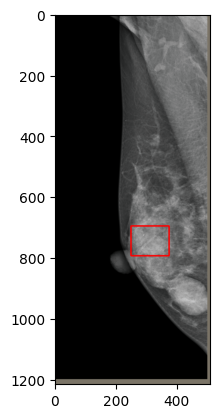

  8%|██████████████████████▋                                                                                                                                                                                                                                                           | 122/1474 [00:55<10:38,  2.12it/s]

(1216, 512, 3)


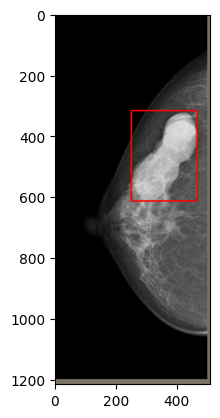

(1216, 512, 3)


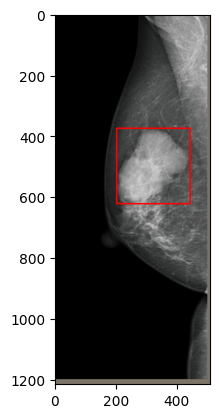

  8%|██████████████████████▊                                                                                                                                                                                                                                                           | 123/1474 [00:55<10:19,  2.18it/s]

(1216, 512, 3)


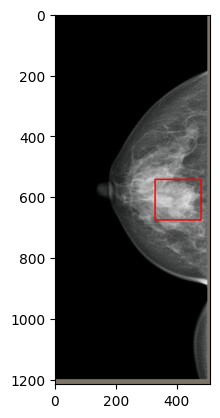

(1216, 512, 3)


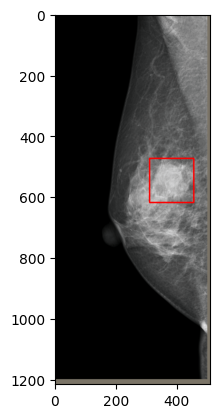

  9%|███████████████████████▍                                                                                                                                                                                                                                                          | 126/1474 [00:56<08:49,  2.55it/s]

(1216, 512, 3)


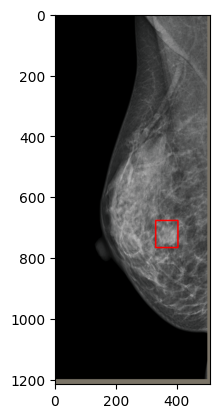

  9%|███████████████████████▊                                                                                                                                                                                                                                                          | 128/1474 [00:57<09:35,  2.34it/s]

(1216, 512, 3)


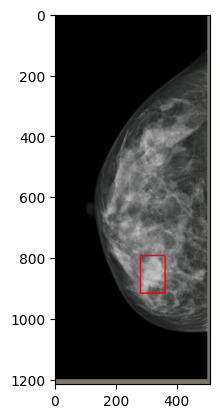

(1216, 512, 3)


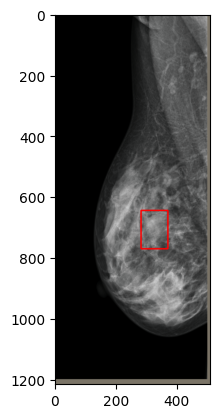

  9%|████████████████████████▏                                                                                                                                                                                                                                                         | 130/1474 [00:58<09:57,  2.25it/s]

(1216, 512, 3)


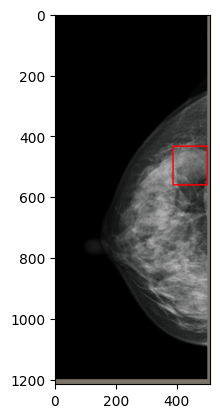

(1216, 512, 3)


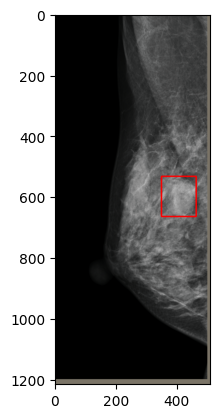

  9%|████████████████████████▌                                                                                                                                                                                                                                                         | 132/1474 [00:59<10:27,  2.14it/s]

(1216, 512, 3)


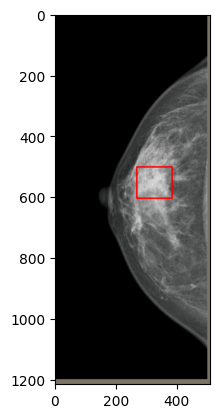

(1216, 512, 3)


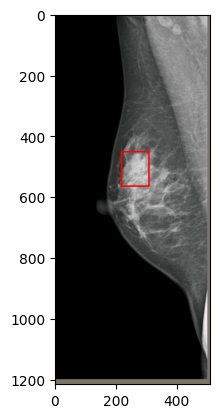

  9%|████████████████████████▉                                                                                                                                                                                                                                                         | 134/1474 [01:00<10:29,  2.13it/s]

(1216, 512, 3)


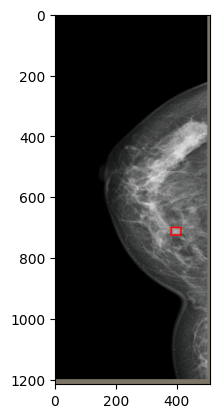

(1216, 512, 3)


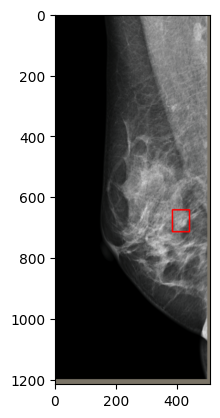

  9%|█████████████████████████▎                                                                                                                                                                                                                                                        | 136/1474 [01:01<09:44,  2.29it/s]

(1216, 512, 3)


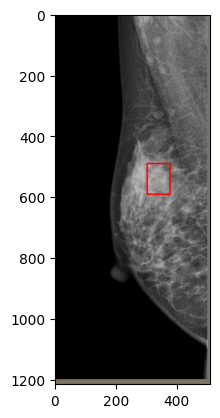

  9%|█████████████████████████▋                                                                                                                                                                                                                                                        | 138/1474 [01:01<08:33,  2.60it/s]

(1216, 512, 3)


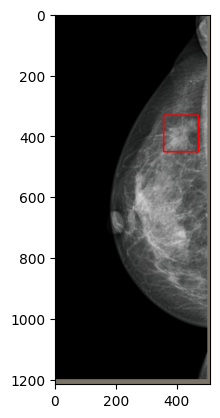

(1216, 512, 3)


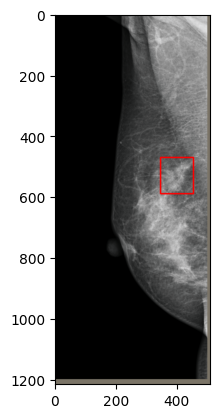

  9%|██████████████████████████                                                                                                                                                                                                                                                        | 140/1474 [01:02<11:05,  2.01it/s]

(1216, 512, 3)


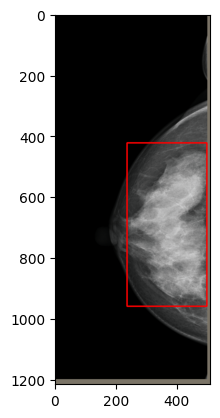

(1216, 512, 3)


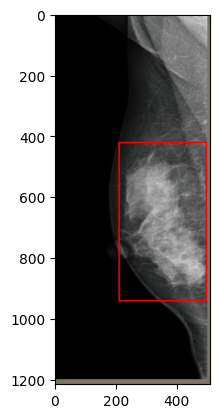

 10%|██████████████████████████▍                                                                                                                                                                                                                                                       | 142/1474 [01:03<10:18,  2.15it/s]

(1216, 512, 3)


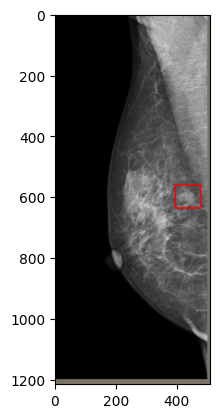

 10%|██████████████████████████▊                                                                                                                                                                                                                                                       | 144/1474 [01:04<10:24,  2.13it/s]

(1216, 512, 3)


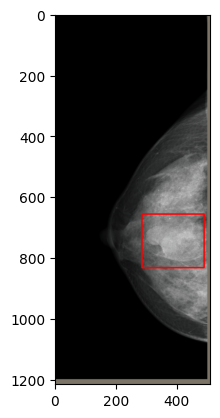

(1216, 512, 3)


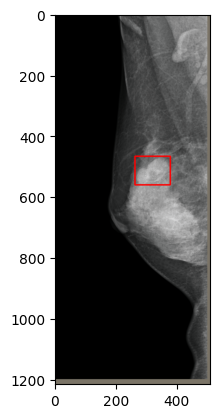

 10%|███████████████████████████▏                                                                                                                                                                                                                                                      | 146/1474 [01:05<08:19,  2.66it/s]

(1216, 512, 3)


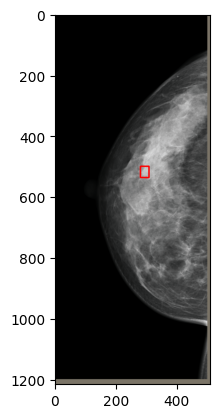

(1216, 512, 3)


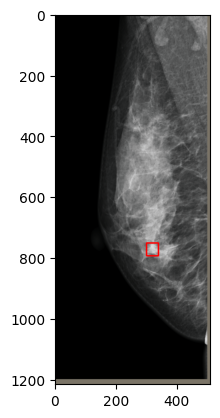

 10%|███████████████████████████▌                                                                                                                                                                                                                                                      | 148/1474 [01:06<11:10,  1.98it/s]

(1216, 512, 3)


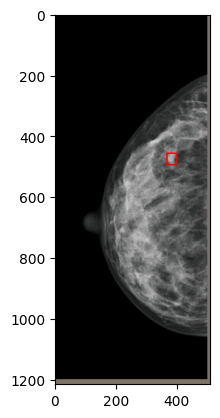

(1216, 512, 3)


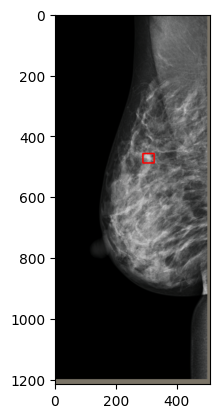

 10%|████████████████████████████                                                                                                                                                                                                                                                      | 151/1474 [01:07<06:55,  3.18it/s]

(1216, 512, 3)


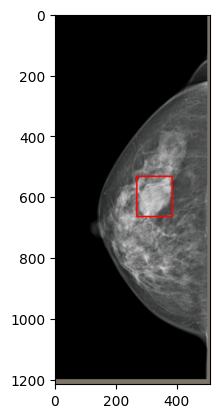

(1216, 512, 3)


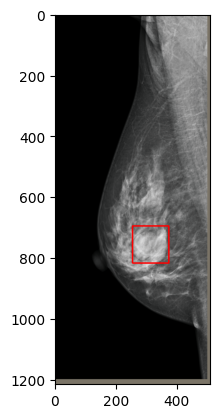

 10%|████████████████████████████▎                                                                                                                                                                                                                                                     | 152/1474 [01:08<12:50,  1.72it/s]

(1216, 512, 3)


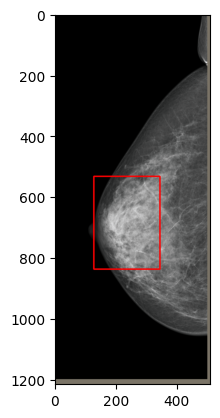

(1216, 512, 3)


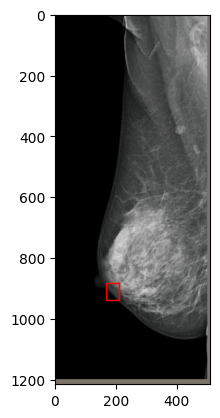

 10%|████████████████████████████▍                                                                                                                                                                                                                                                     | 153/1474 [01:08<11:47,  1.87it/s]

(1216, 512, 3)


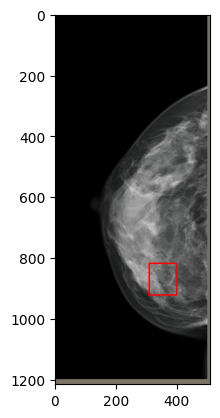

(1216, 512, 3)


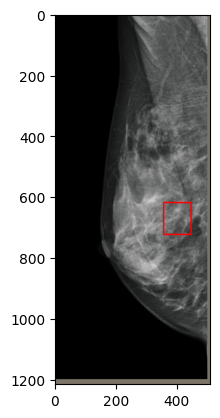

 11%|████████████████████████████▉                                                                                                                                                                                                                                                     | 156/1474 [01:09<09:02,  2.43it/s]

(1216, 512, 3)


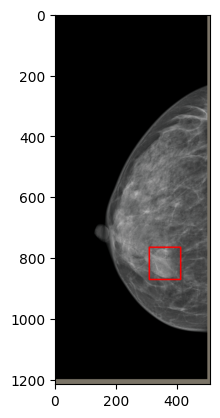

(1216, 512, 3)


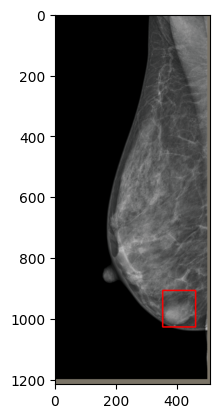

 11%|█████████████████████████████▏                                                                                                                                                                                                                                                    | 157/1474 [01:10<08:58,  2.45it/s]

(1216, 512, 3)


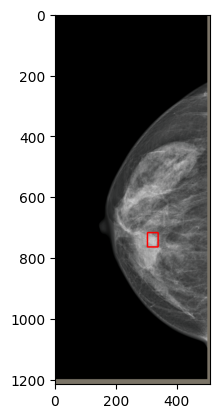

(1216, 512, 3)


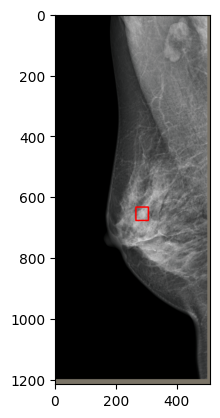

 11%|█████████████████████████████▋                                                                                                                                                                                                                                                    | 160/1474 [01:11<07:13,  3.03it/s]

(1216, 512, 3)


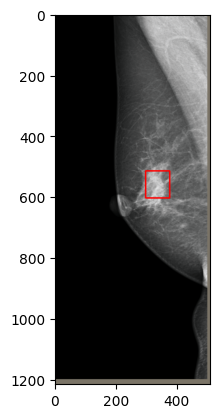

 11%|█████████████████████████████▉                                                                                                                                                                                                                                                    | 161/1474 [01:11<06:42,  3.26it/s]

(1216, 512, 3)


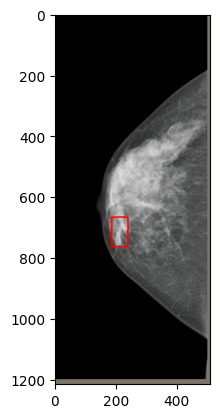

(1216, 512, 3)


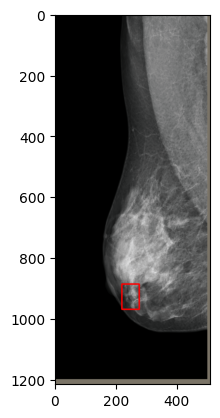

 11%|██████████████████████████████▍                                                                                                                                                                                                                                                   | 164/1474 [01:12<10:53,  2.01it/s]

(1216, 512, 3)


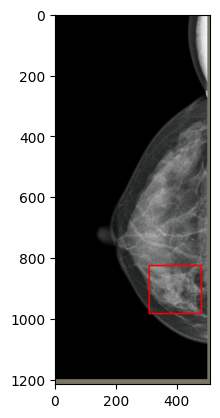

(1216, 512, 3)


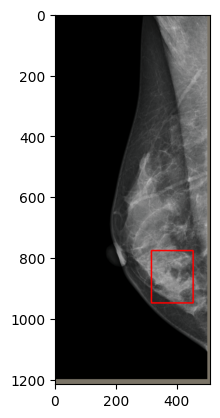

 11%|██████████████████████████████▊                                                                                                                                                                                                                                                   | 166/1474 [01:13<09:54,  2.20it/s]

(1216, 512, 3)


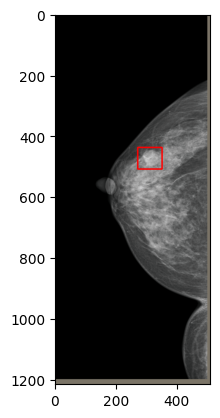

(1216, 512, 3)


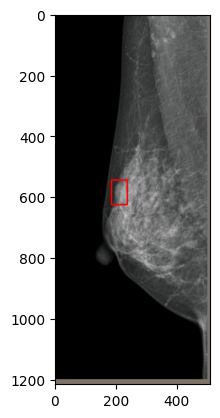

 11%|███████████████████████████████▏                                                                                                                                                                                                                                                  | 168/1474 [01:14<10:05,  2.16it/s]

(1216, 512, 3)


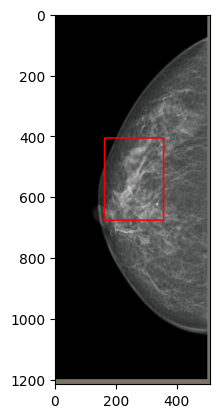

(1216, 512, 3)


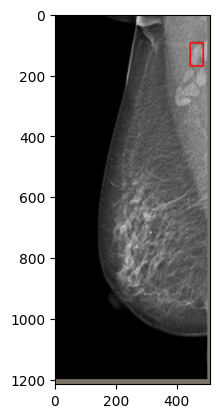

 11%|███████████████████████████████▍                                                                                                                                                                                                                                                  | 169/1474 [01:15<09:52,  2.20it/s]

(1216, 512, 3)


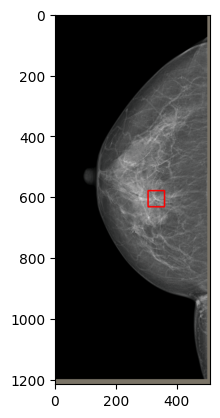

(1216, 512, 3)


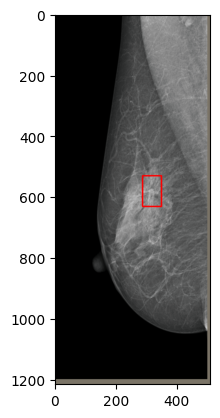

 12%|███████████████████████████████▉                                                                                                                                                                                                                                                  | 172/1474 [01:16<10:22,  2.09it/s]

(1216, 512, 3)


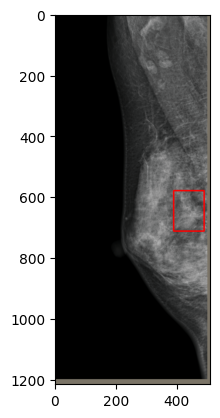

 12%|████████████████████████████████▌                                                                                                                                                                                                                                                 | 175/1474 [01:16<06:11,  3.50it/s]

(1216, 512, 3)


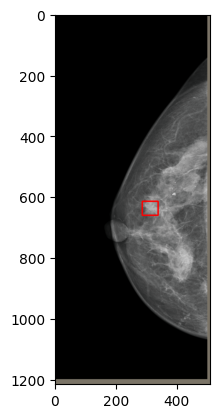

(1216, 512, 3)


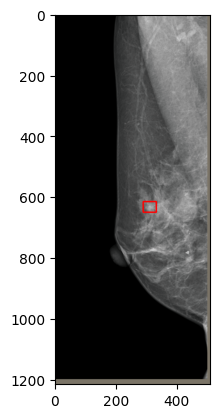

 12%|████████████████████████████████▋                                                                                                                                                                                                                                                 | 176/1474 [01:18<11:46,  1.84it/s]

(1216, 512, 3)


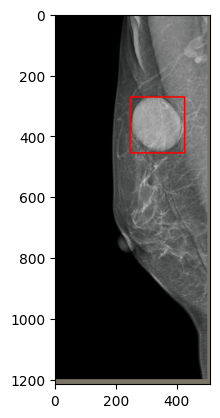

 12%|█████████████████████████████████▎                                                                                                                                                                                                                                                | 179/1474 [01:18<06:47,  3.18it/s]

(1216, 512, 3)


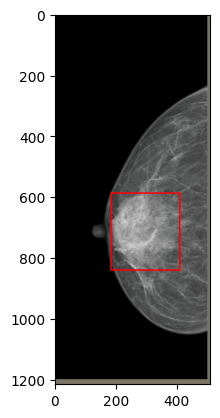

(1216, 512, 3)


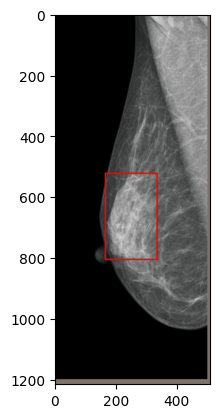

 12%|█████████████████████████████████▍                                                                                                                                                                                                                                                | 180/1474 [01:20<13:10,  1.64it/s]

(1216, 512, 3)


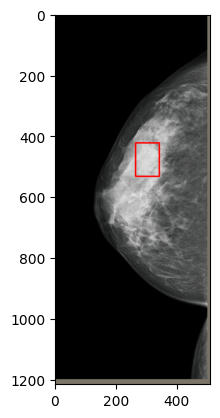

(1216, 512, 3)


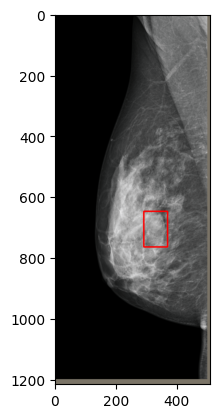

 12%|██████████████████████████████████                                                                                                                                                                                                                                                | 183/1474 [01:20<07:45,  2.77it/s]

(1216, 512, 3)


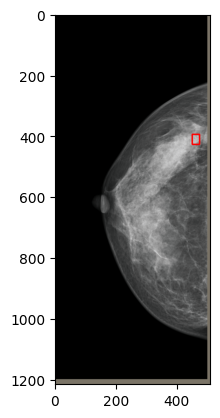

(1216, 512, 3)


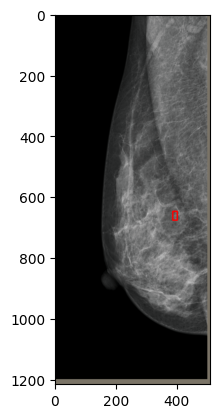

 12%|██████████████████████████████████▏                                                                                                                                                                                                                                               | 184/1474 [01:22<11:50,  1.82it/s]

(1216, 512, 3)


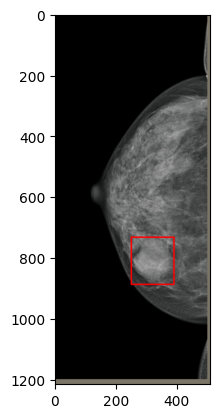

(1216, 512, 3)


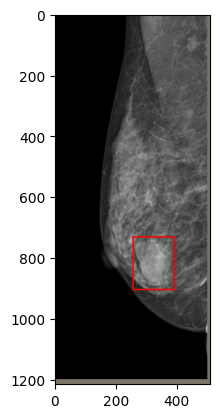

 13%|██████████████████████████████████▍                                                                                                                                                                                                                                               | 185/1474 [01:22<12:36,  1.70it/s]

(1216, 512, 3)


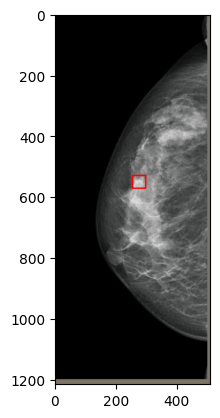

(1216, 512, 3)


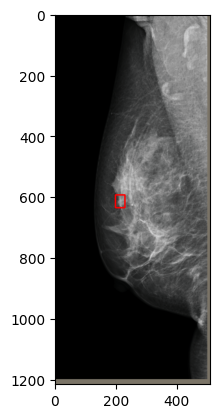

 13%|██████████████████████████████████▉                                                                                                                                                                                                                                               | 188/1474 [01:24<11:21,  1.89it/s]

(1216, 512, 3)


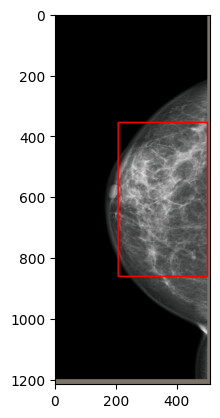

(1216, 512, 3)


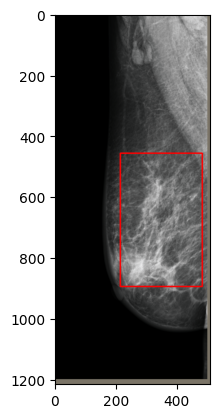

 13%|███████████████████████████████████▎                                                                                                                                                                                                                                              | 190/1474 [01:24<08:48,  2.43it/s]

(1216, 512, 3)


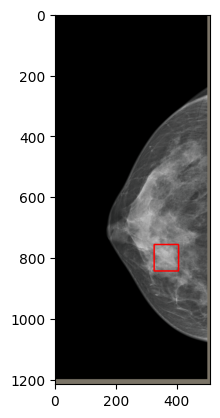

(1216, 512, 3)


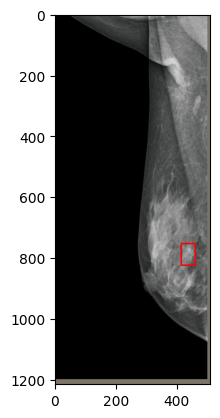

 13%|███████████████████████████████████▋                                                                                                                                                                                                                                              | 192/1474 [01:26<12:25,  1.72it/s]

(1216, 512, 3)


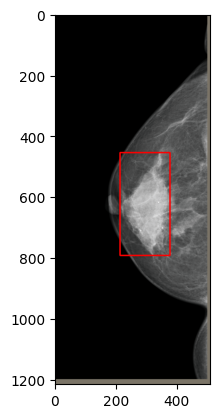

(1216, 512, 3)


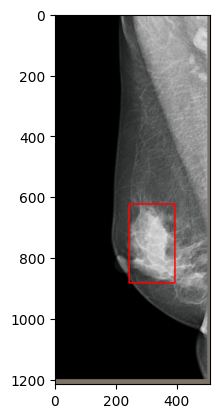

 13%|████████████████████████████████████                                                                                                                                                                                                                                              | 194/1474 [01:26<10:00,  2.13it/s]

(1216, 512, 3)


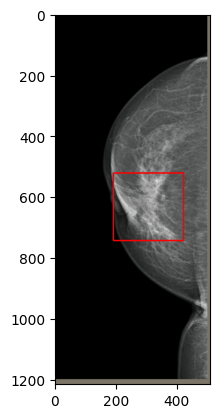

(1216, 512, 3)


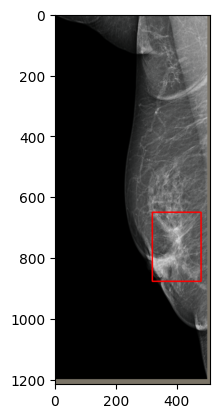

 13%|████████████████████████████████████▍                                                                                                                                                                                                                                             | 196/1474 [01:27<09:55,  2.15it/s]

(1216, 512, 3)


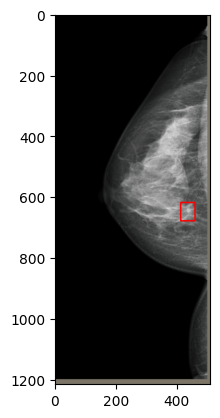

(1216, 512, 3)


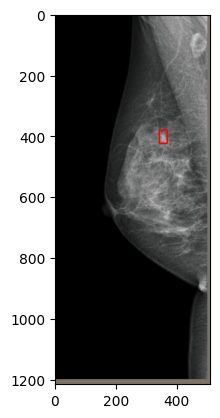

 13%|████████████████████████████████████▊                                                                                                                                                                                                                                             | 198/1474 [01:28<09:07,  2.33it/s]

(1216, 512, 3)


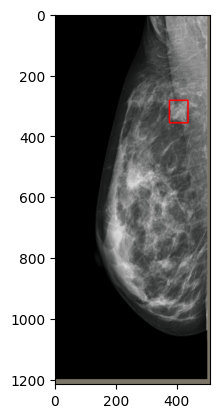

 14%|█████████████████████████████████████▏                                                                                                                                                                                                                                            | 200/1474 [01:29<11:00,  1.93it/s]

(1216, 512, 3)


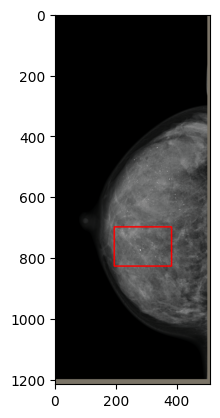

(1216, 512, 3)


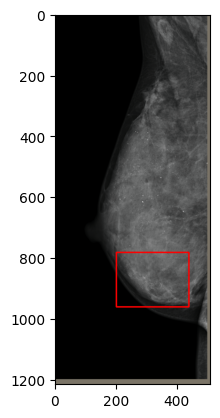

 14%|█████████████████████████████████████▎                                                                                                                                                                                                                                            | 201/1474 [01:30<10:38,  2.00it/s]

(1216, 512, 3)


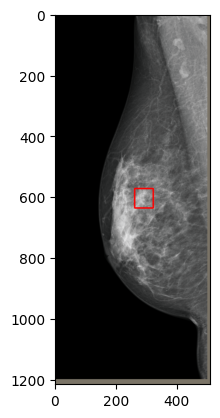

 14%|█████████████████████████████████████▉                                                                                                                                                                                                                                            | 204/1474 [01:31<09:53,  2.14it/s]

(1216, 512, 3)


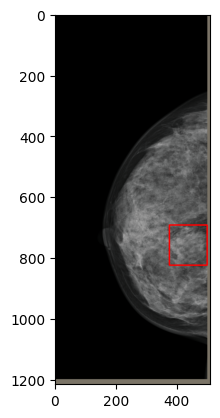

(1216, 512, 3)


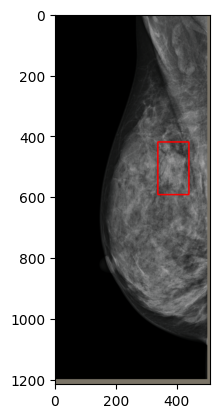

 14%|██████████████████████████████████████▎                                                                                                                                                                                                                                           | 206/1474 [01:32<09:15,  2.28it/s]

(1216, 512, 3)


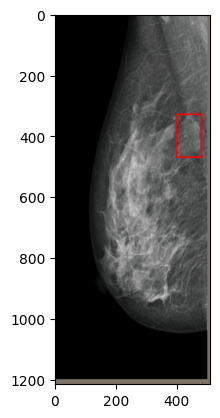

 14%|██████████████████████████████████████▋                                                                                                                                                                                                                                           | 208/1474 [01:32<08:45,  2.41it/s]

(1216, 512, 3)


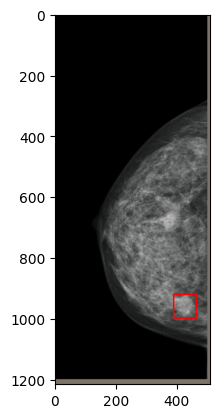

(1216, 512, 3)


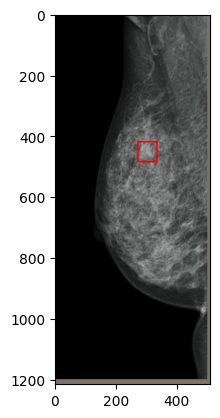

 14%|███████████████████████████████████████                                                                                                                                                                                                                                           | 210/1474 [01:34<13:09,  1.60it/s]

(1216, 512, 3)


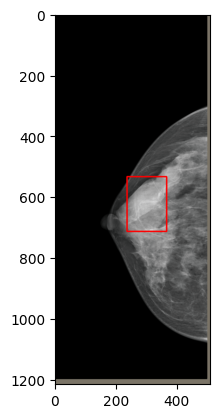

(1216, 512, 3)


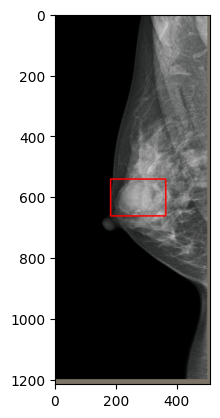

 14%|███████████████████████████████████████▌                                                                                                                                                                                                                                          | 213/1474 [01:35<08:13,  2.56it/s]

(1216, 512, 3)


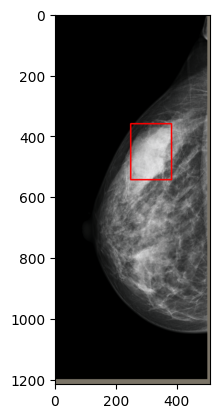

(1216, 512, 3)


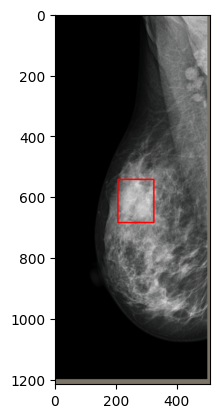

 15%|███████████████████████████████████████▊                                                                                                                                                                                                                                          | 214/1474 [01:36<12:26,  1.69it/s]

(1216, 512, 3)


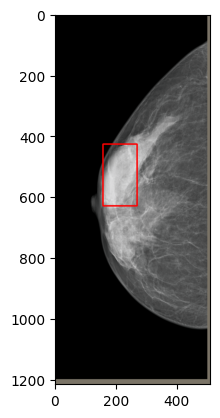

(1216, 512, 3)


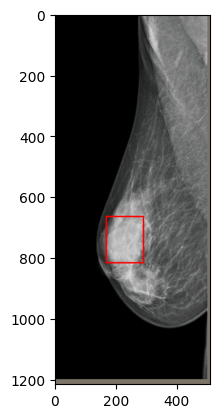

 15%|████████████████████████████████████████▏                                                                                                                                                                                                                                         | 216/1474 [01:37<09:29,  2.21it/s]

(1216, 512, 3)


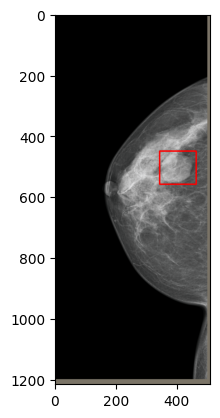

(1216, 512, 3)


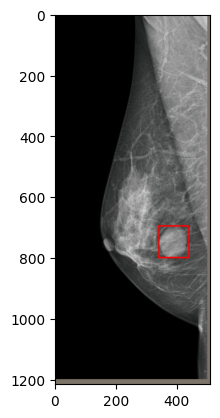

 15%|████████████████████████████████████████▌                                                                                                                                                                                                                                         | 218/1474 [01:38<10:20,  2.03it/s]

(1216, 512, 3)


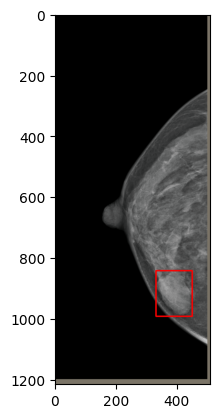

(1216, 512, 3)


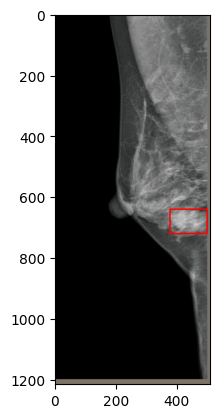

 15%|████████████████████████████████████████▋                                                                                                                                                                                                                                         | 219/1474 [01:38<09:43,  2.15it/s]

(1216, 512, 3)


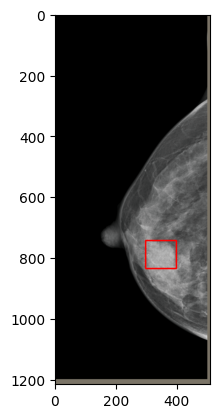

(1216, 512, 3)


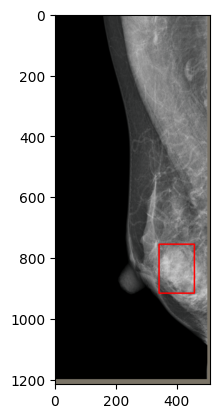

 15%|████████████████████████████████████████▉                                                                                                                                                                                                                                         | 220/1474 [01:39<10:14,  2.04it/s]

(1216, 512, 3)


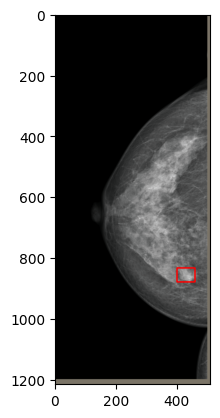

(1216, 512, 3)


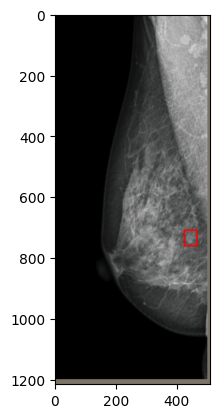

 15%|█████████████████████████████████████████▎                                                                                                                                                                                                                                        | 222/1474 [01:39<09:18,  2.24it/s]

(1216, 512, 3)


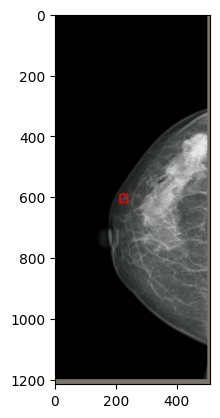

(1216, 512, 3)


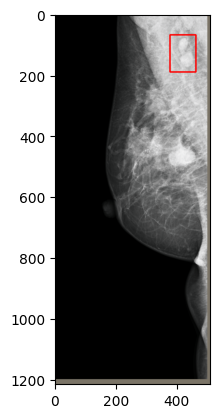

 15%|█████████████████████████████████████████▋                                                                                                                                                                                                                                        | 224/1474 [01:40<09:03,  2.30it/s]

(1216, 512, 3)


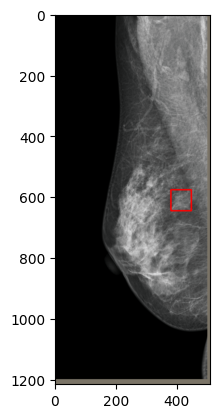

 15%|██████████████████████████████████████████                                                                                                                                                                                                                                        | 226/1474 [01:42<13:02,  1.59it/s]

(1216, 512, 3)


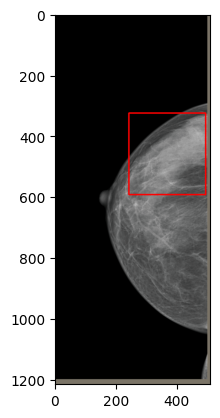

(1216, 512, 3)


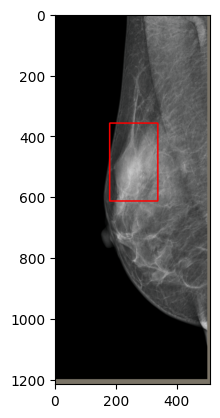

 15%|██████████████████████████████████████████▍                                                                                                                                                                                                                                       | 228/1474 [01:42<08:54,  2.33it/s]

(1216, 512, 3)


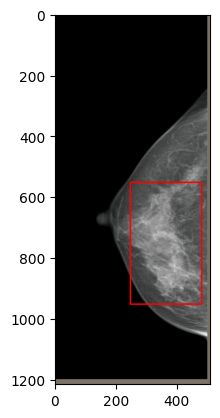

(1216, 512, 3)


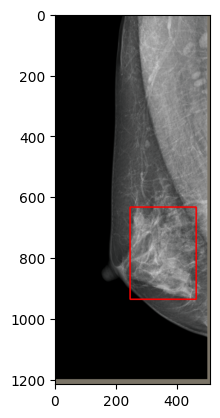

 16%|██████████████████████████████████████████▊                                                                                                                                                                                                                                       | 230/1474 [01:44<10:46,  1.92it/s]

(1216, 512, 3)


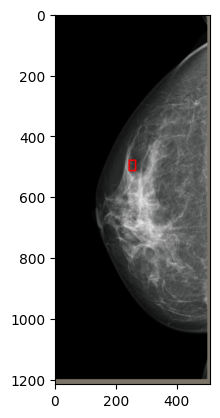

(1216, 512, 3)


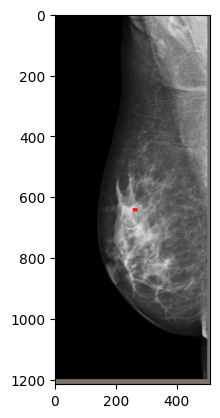

 16%|██████████████████████████████████████████▉                                                                                                                                                                                                                                       | 231/1474 [01:44<10:10,  2.04it/s]

(1216, 512, 3)


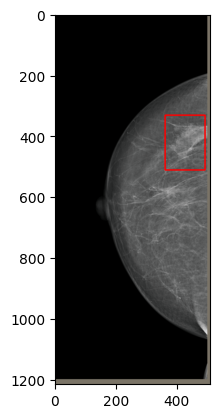

(1216, 512, 3)


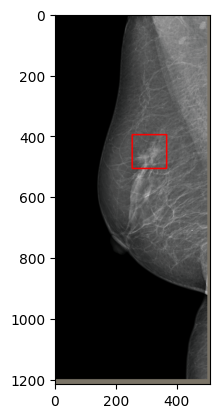

 16%|███████████████████████████████████████████▎                                                                                                                                                                                                                                      | 233/1474 [01:44<07:59,  2.59it/s]

(1216, 512, 3)


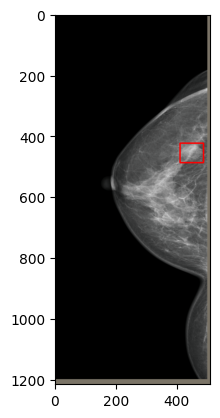

(1216, 512, 3)


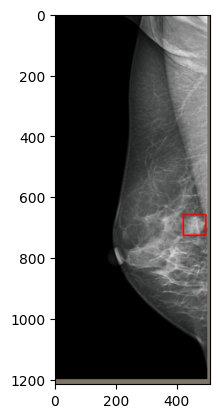

 16%|███████████████████████████████████████████▊                                                                                                                                                                                                                                      | 236/1474 [01:45<06:02,  3.41it/s]

(1216, 512, 3)


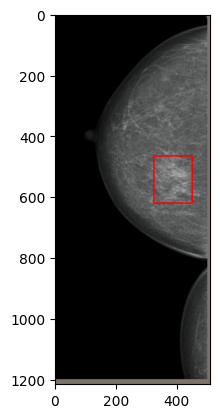

(1216, 512, 3)


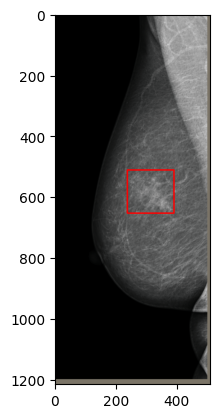

 16%|████████████████████████████████████████████▏                                                                                                                                                                                                                                     | 238/1474 [01:46<08:38,  2.39it/s]

(1216, 512, 3)


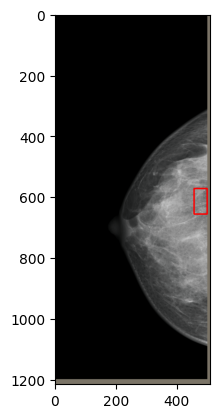

(1216, 512, 3)


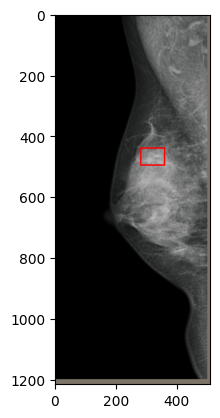

 16%|████████████████████████████████████████████▍                                                                                                                                                                                                                                     | 239/1474 [01:47<08:34,  2.40it/s]

(1216, 512, 3)


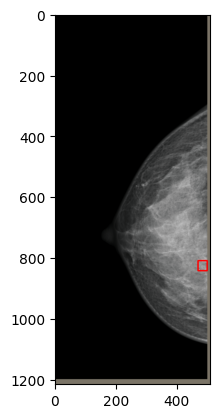

(1216, 512, 3)


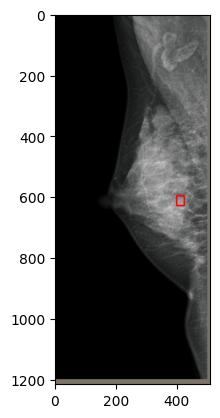

 16%|████████████████████████████████████████████▌                                                                                                                                                                                                                                     | 240/1474 [01:47<08:42,  2.36it/s]

(1216, 512, 3)


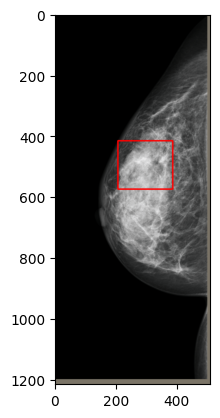

(1216, 512, 3)


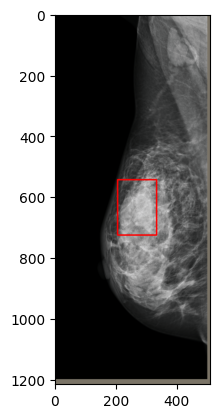

 16%|████████████████████████████████████████████▉                                                                                                                                                                                                                                     | 242/1474 [01:48<10:33,  1.94it/s]

(1216, 512, 3)


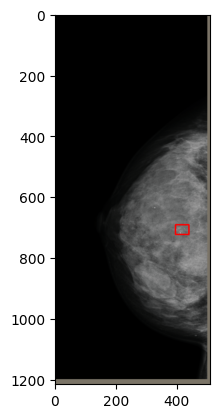

(1216, 512, 3)


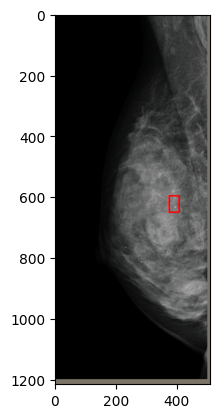

 16%|█████████████████████████████████████████████▏                                                                                                                                                                                                                                    | 243/1474 [01:49<09:51,  2.08it/s]

(1216, 512, 3)


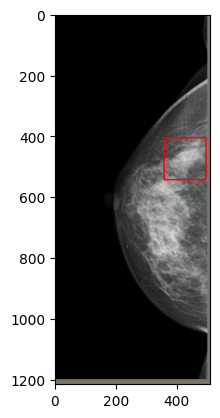

(1216, 512, 3)


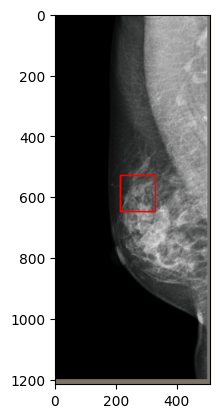

 17%|█████████████████████████████████████████████▋                                                                                                                                                                                                                                    | 246/1474 [01:50<11:26,  1.79it/s]

(1216, 512, 3)


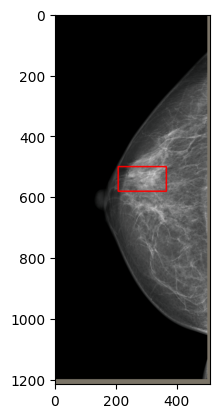

(1216, 512, 3)


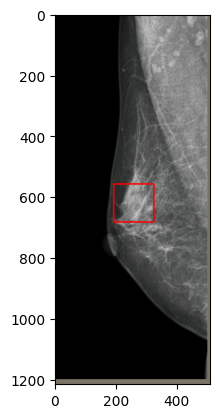

 17%|██████████████████████████████████████████████                                                                                                                                                                                                                                    | 248/1474 [01:51<08:33,  2.39it/s]

(1216, 512, 3)


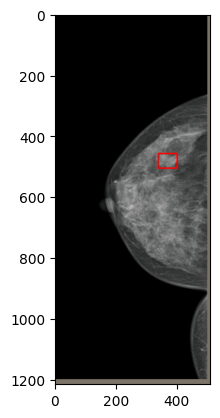

(1216, 512, 3)


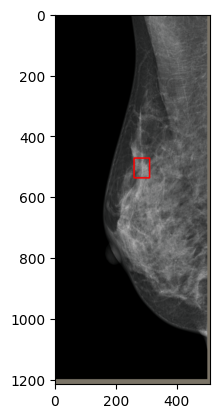

 17%|██████████████████████████████████████████████▍                                                                                                                                                                                                                                   | 250/1474 [01:52<12:02,  1.69it/s]

(1216, 512, 3)


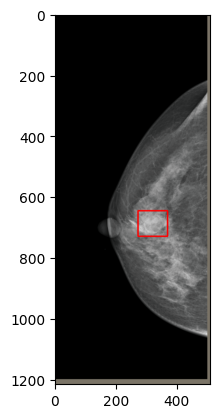

(1216, 512, 3)


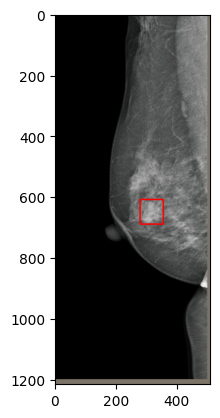

 17%|██████████████████████████████████████████████▊                                                                                                                                                                                                                                   | 252/1474 [01:53<10:29,  1.94it/s]

(1216, 512, 3)


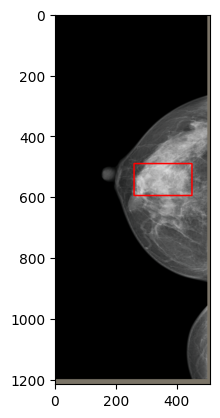

(1216, 512, 3)


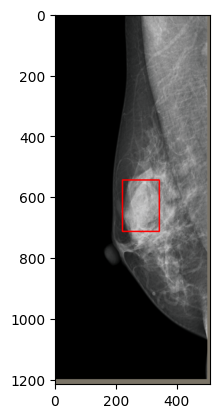

 17%|███████████████████████████████████████████████▏                                                                                                                                                                                                                                  | 254/1474 [01:55<13:15,  1.53it/s]

(1216, 512, 3)


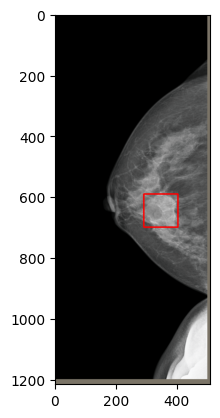

(1216, 512, 3)


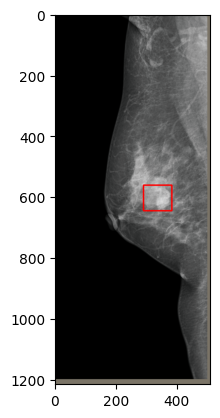

 17%|███████████████████████████████████████████████▍                                                                                                                                                                                                                                  | 255/1474 [01:55<12:08,  1.67it/s]

(1216, 512, 3)


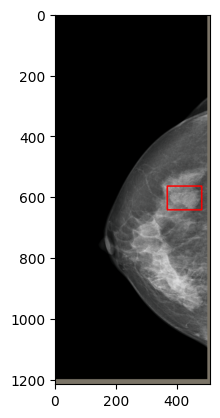

(1216, 512, 3)


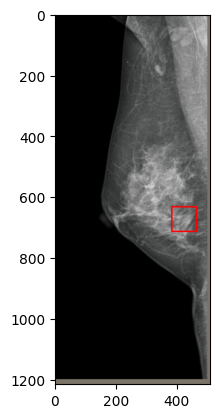

 17%|███████████████████████████████████████████████▌                                                                                                                                                                                                                                  | 256/1474 [01:56<11:12,  1.81it/s]

(1216, 512, 3)


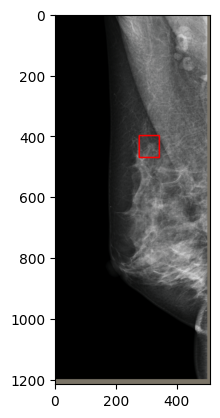

 18%|███████████████████████████████████████████████▉                                                                                                                                                                                                                                  | 258/1474 [01:56<09:28,  2.14it/s]

(1216, 512, 3)


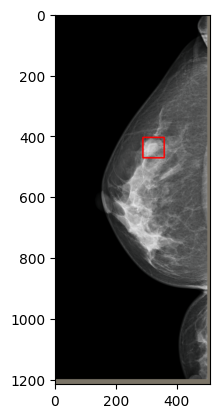

(1216, 512, 3)


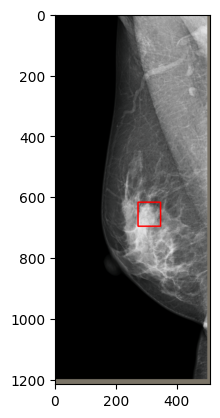

 18%|████████████████████████████████████████████████▏                                                                                                                                                                                                                                 | 259/1474 [01:57<09:17,  2.18it/s]

(1216, 512, 3)


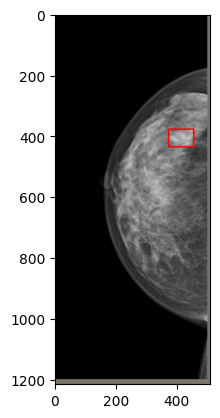

(1216, 512, 3)


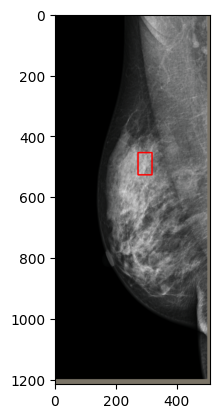

 18%|████████████████████████████████████████████████▋                                                                                                                                                                                                                                 | 262/1474 [01:58<08:59,  2.25it/s]

(1216, 512, 3)


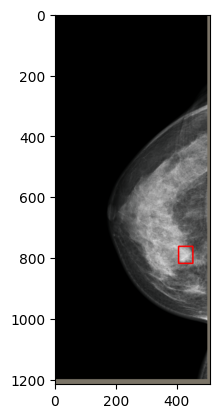

 18%|█████████████████████████████████████████████████                                                                                                                                                                                                                                 | 264/1474 [01:58<06:53,  2.92it/s]

(1216, 512, 3)


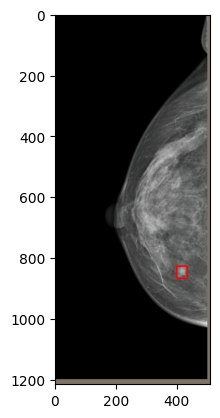

(1216, 512, 3)


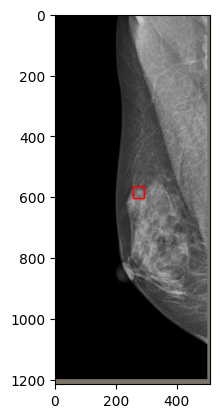

 18%|█████████████████████████████████████████████████▍                                                                                                                                                                                                                                | 266/1474 [02:01<14:43,  1.37it/s]

(1216, 512, 3)


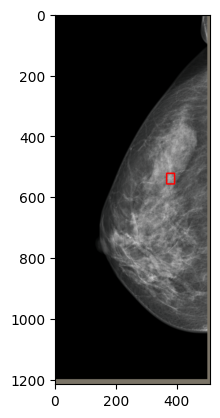

(1216, 512, 3)


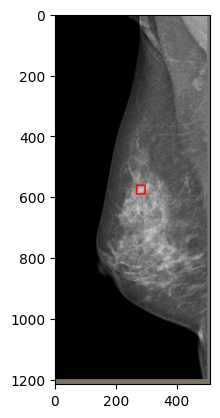

 18%|██████████████████████████████████████████████████                                                                                                                                                                                                                                | 269/1474 [02:02<09:01,  2.22it/s]

(1216, 512, 3)


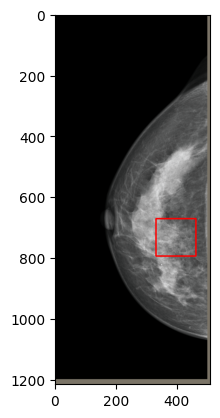

(1216, 512, 3)


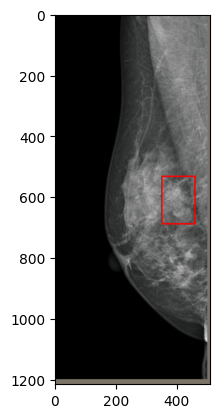

 18%|██████████████████████████████████████████████████▏                                                                                                                                                                                                                               | 270/1474 [02:03<13:33,  1.48it/s]

(1216, 512, 3)


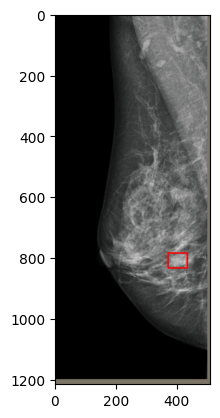

 18%|██████████████████████████████████████████████████▌                                                                                                                                                                                                                               | 272/1474 [02:05<13:51,  1.45it/s]

(1216, 512, 3)


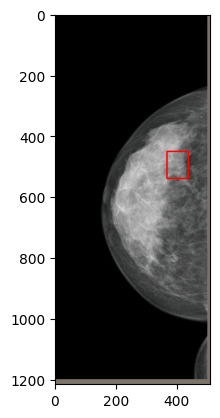

(1216, 512, 3)


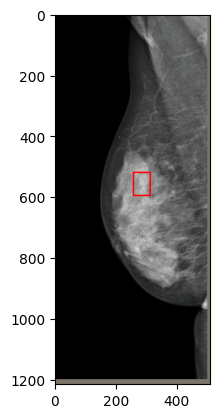

 19%|██████████████████████████████████████████████████▉                                                                                                                                                                                                                               | 274/1474 [02:06<15:09,  1.32it/s]

(1216, 512, 3)


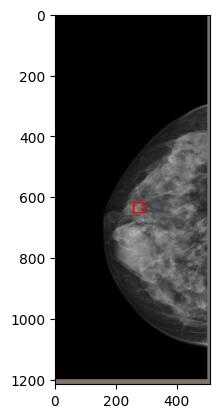

(1216, 512, 3)


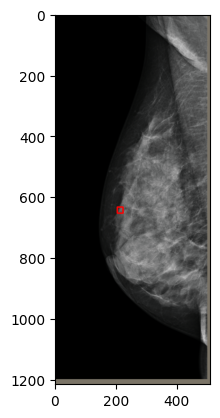

 19%|███████████████████████████████████████████████████▎                                                                                                                                                                                                                              | 276/1474 [02:07<13:08,  1.52it/s]

(1216, 512, 3)


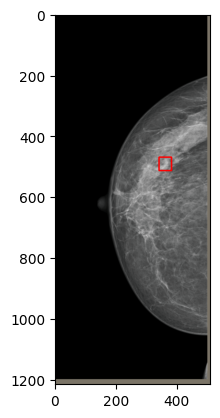

(1216, 512, 3)


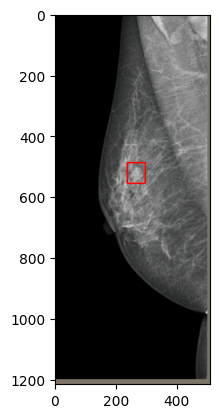

 19%|███████████████████████████████████████████████████▋                                                                                                                                                                                                                              | 278/1474 [02:08<12:10,  1.64it/s]

(1216, 512, 3)


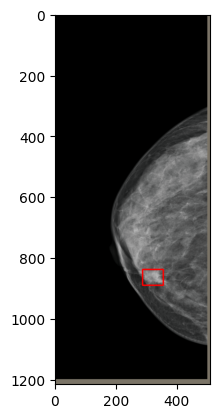

(1216, 512, 3)


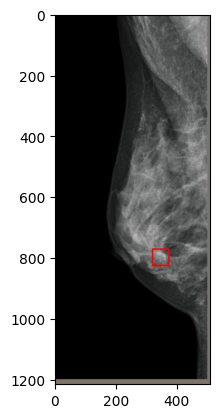

 19%|████████████████████████████████████████████████████                                                                                                                                                                                                                              | 280/1474 [02:10<13:51,  1.44it/s]

(1216, 512, 3)


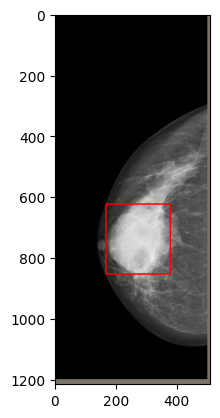

(1216, 512, 3)


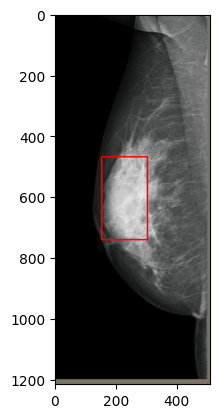

 19%|████████████████████████████████████████████████████▍                                                                                                                                                                                                                             | 282/1474 [02:11<12:42,  1.56it/s]

(1216, 512, 3)


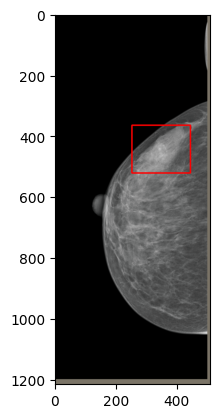

(1216, 512, 3)


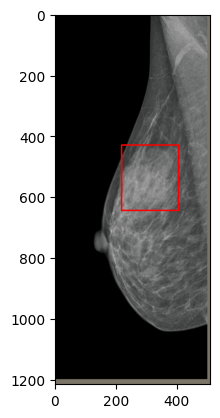

 19%|████████████████████████████████████████████████████▊                                                                                                                                                                                                                             | 284/1474 [02:12<10:27,  1.90it/s]

(1216, 512, 3)


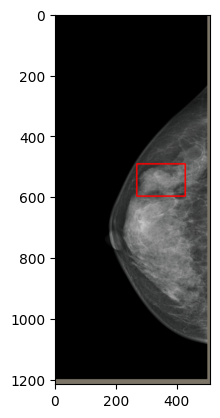

(1216, 512, 3)


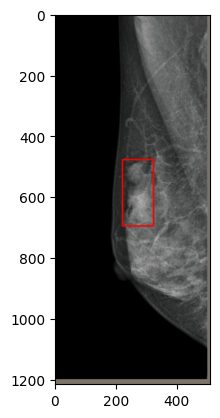

 19%|█████████████████████████████████████████████████████▏                                                                                                                                                                                                                            | 286/1474 [02:14<13:07,  1.51it/s]

(1216, 512, 3)


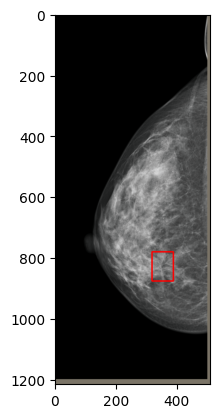

(1216, 512, 3)


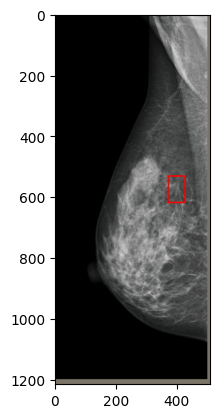

 20%|█████████████████████████████████████████████████████▌                                                                                                                                                                                                                            | 288/1474 [02:15<12:17,  1.61it/s]

(1216, 512, 3)


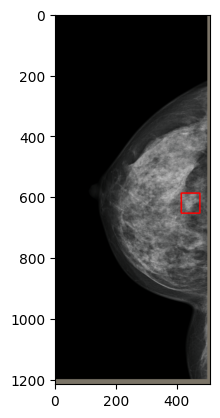

(1216, 512, 3)


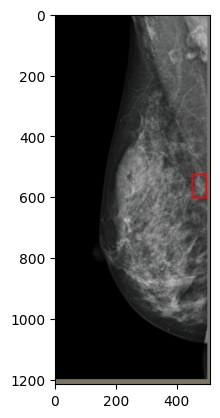

 20%|█████████████████████████████████████████████████████▉                                                                                                                                                                                                                            | 290/1474 [02:17<15:02,  1.31it/s]

(1216, 512, 3)


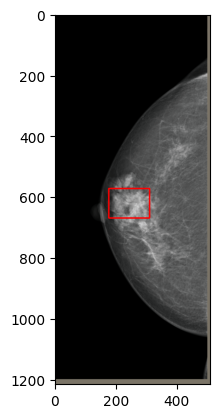

(1216, 512, 3)


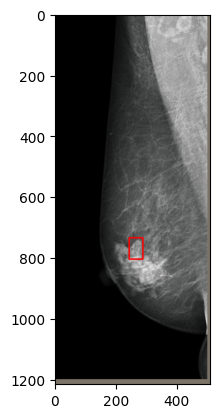

 20%|██████████████████████████████████████████████████████▎                                                                                                                                                                                                                           | 292/1474 [02:17<11:35,  1.70it/s]

(1216, 512, 3)


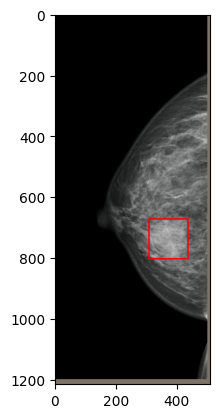

(1216, 512, 3)


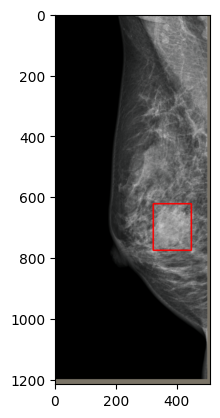

 20%|██████████████████████████████████████████████████████▋                                                                                                                                                                                                                           | 294/1474 [02:19<12:34,  1.56it/s]

(1216, 512, 3)


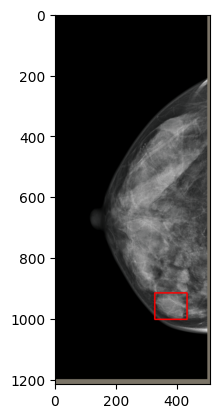

(1216, 512, 3)


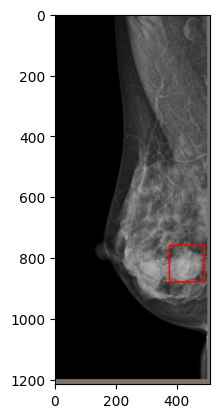

 20%|███████████████████████████████████████████████████████                                                                                                                                                                                                                           | 296/1474 [02:20<12:06,  1.62it/s]

(1216, 512, 3)


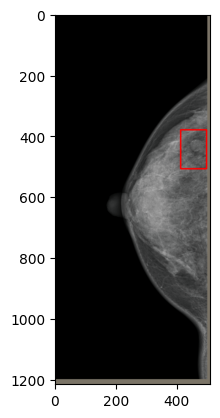

(1216, 512, 3)


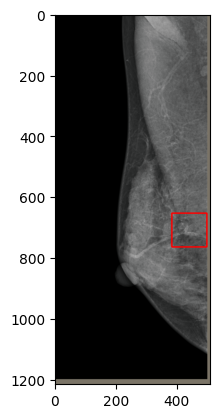

 20%|███████████████████████████████████████████████████████▍                                                                                                                                                                                                                          | 298/1474 [02:21<13:11,  1.49it/s]

(1216, 512, 3)


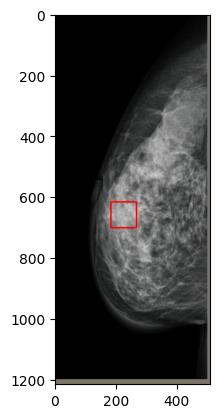

(1216, 512, 3)


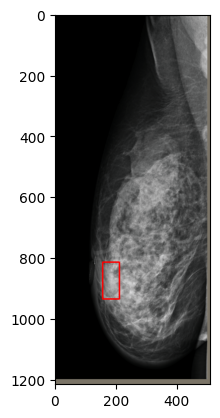

 20%|███████████████████████████████████████████████████████▊                                                                                                                                                                                                                          | 300/1474 [02:22<11:04,  1.77it/s]

(1216, 512, 3)


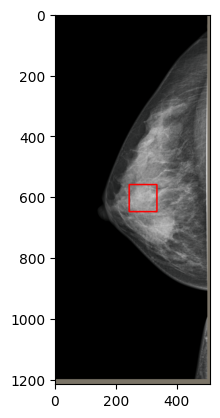

(1216, 512, 3)


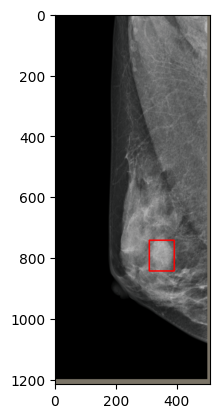

 20%|████████████████████████████████████████████████████████▏                                                                                                                                                                                                                         | 302/1474 [02:24<16:05,  1.21it/s]

(1216, 512, 3)


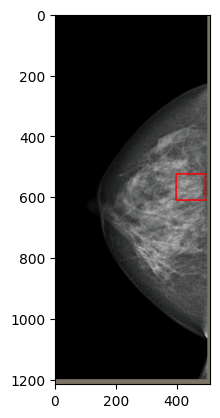

(1216, 512, 3)


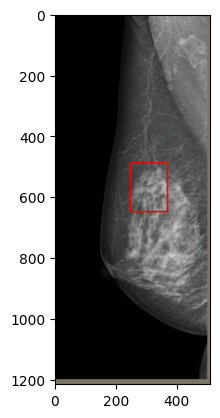

 21%|████████████████████████████████████████████████████████▎                                                                                                                                                                                                                         | 303/1474 [02:24<13:55,  1.40it/s]

(1216, 512, 3)


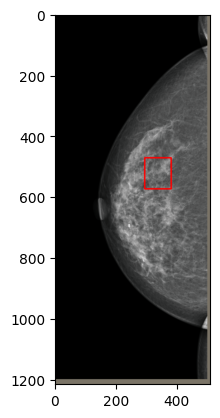

(1216, 512, 3)


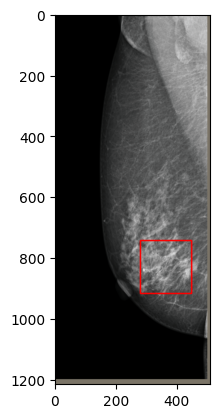

 21%|████████████████████████████████████████████████████████▉                                                                                                                                                                                                                         | 306/1474 [02:27<17:46,  1.10it/s]

(1216, 512, 3)


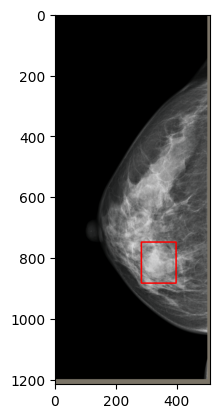

(1216, 512, 3)


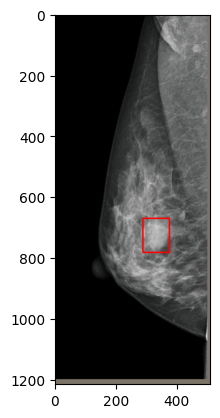

 21%|█████████████████████████████████████████████████████████▍                                                                                                                                                                                                                        | 309/1474 [02:28<09:37,  2.02it/s]

(1216, 512, 3)


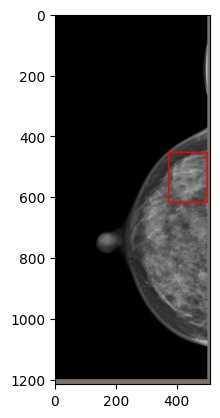

(1216, 512, 3)


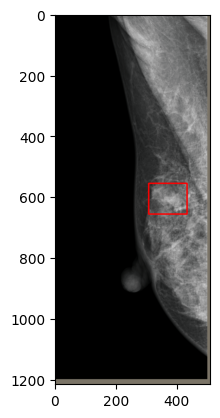

 21%|█████████████████████████████████████████████████████████▋                                                                                                                                                                                                                        | 310/1474 [02:30<15:54,  1.22it/s]

(1216, 512, 3)


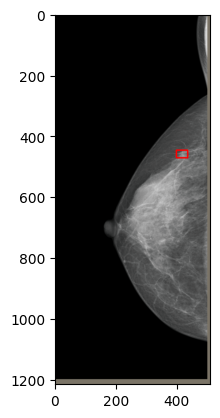

(1216, 512, 3)


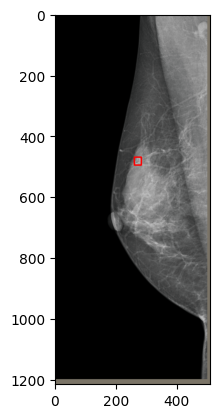

 21%|█████████████████████████████████████████████████████████▊                                                                                                                                                                                                                        | 311/1474 [02:30<13:50,  1.40it/s]

(1216, 512, 3)


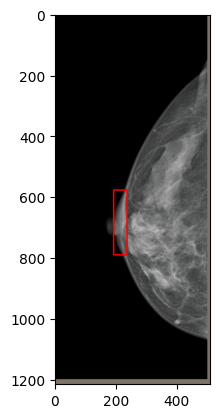

(1216, 512, 3)


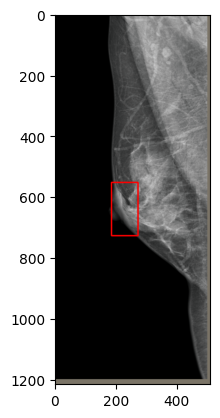

 21%|██████████████████████████████████████████████████████████▎                                                                                                                                                                                                                       | 314/1474 [02:32<13:17,  1.45it/s]

(1216, 512, 3)


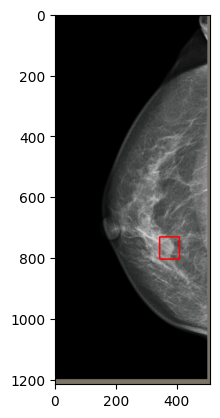

(1216, 512, 3)


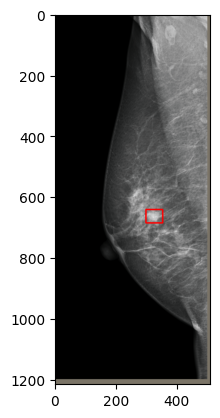

 22%|██████████████████████████████████████████████████████████▉                                                                                                                                                                                                                       | 317/1474 [02:32<07:34,  2.55it/s]

(1216, 512, 3)


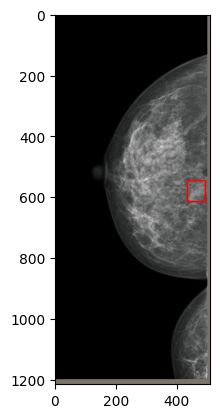

(1216, 512, 3)


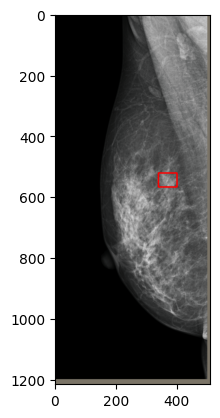

 22%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                       | 318/1474 [02:35<15:40,  1.23it/s]

(1216, 512, 3)


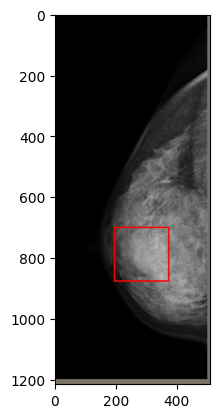

(1216, 512, 3)


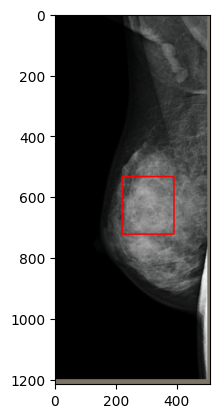

 22%|███████████████████████████████████████████████████████████▋                                                                                                                                                                                                                      | 321/1474 [02:35<08:37,  2.23it/s]

(1216, 512, 3)


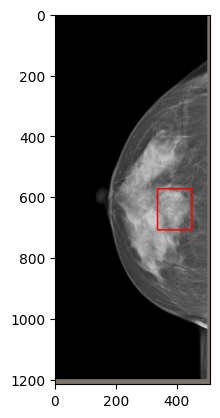

(1216, 512, 3)


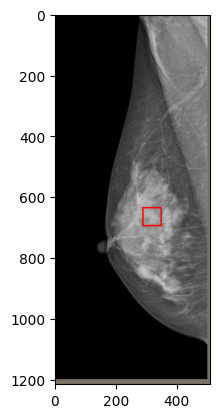

 22%|███████████████████████████████████████████████████████████▊                                                                                                                                                                                                                      | 322/1474 [02:36<12:26,  1.54it/s]

(1216, 512, 3)


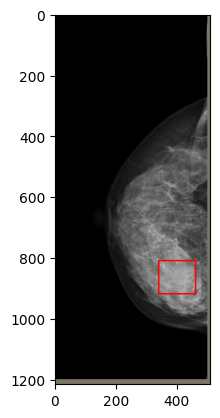

(1216, 512, 3)


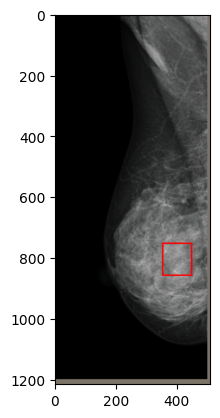

 22%|████████████████████████████████████████████████████████████▏                                                                                                                                                                                                                     | 324/1474 [02:37<09:20,  2.05it/s]

(1216, 512, 3)


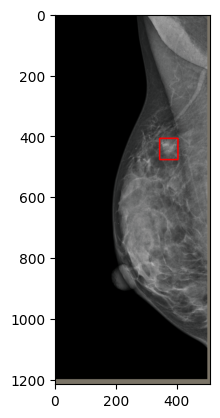

 22%|████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                     | 326/1474 [02:39<12:43,  1.50it/s]

(1216, 512, 3)


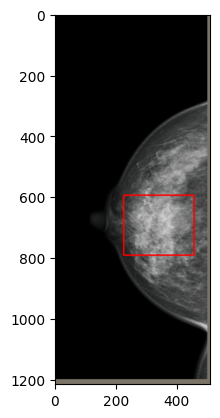

(1216, 512, 3)


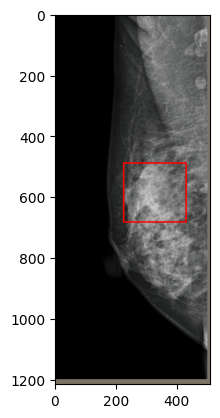

 22%|████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                     | 328/1474 [02:39<10:21,  1.84it/s]

(1216, 512, 3)


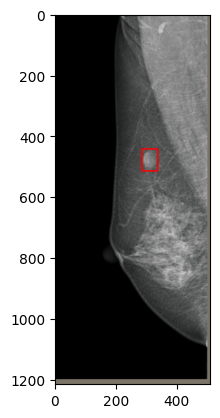

 22%|█████████████████████████████████████████████████████████████▎                                                                                                                                                                                                                    | 330/1474 [02:41<12:24,  1.54it/s]

(1216, 512, 3)


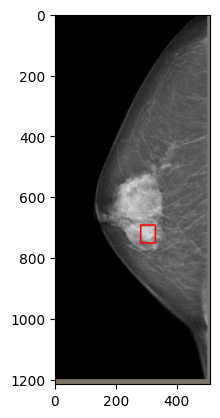

(1216, 512, 3)


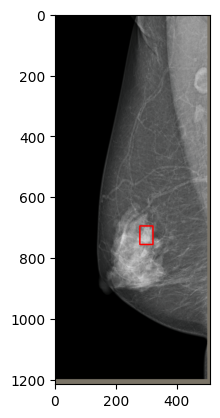

 22%|█████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                    | 331/1474 [02:41<11:26,  1.66it/s]

(1216, 512, 3)


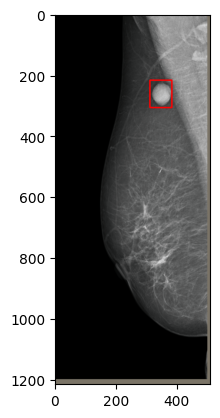

 23%|██████████████████████████████████████████████████████████████                                                                                                                                                                                                                    | 334/1474 [02:43<13:00,  1.46it/s]

(1216, 512, 3)


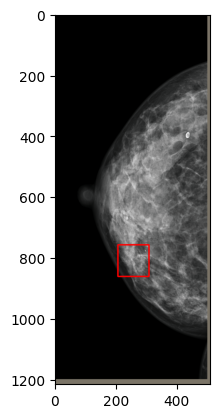

(1216, 512, 3)


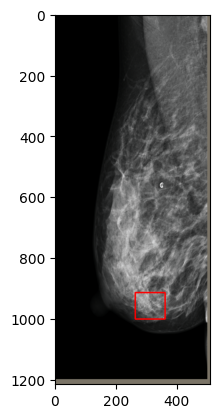

 23%|██████████████████████████████████████████████████████████████▎                                                                                                                                                                                                                   | 335/1474 [02:44<12:30,  1.52it/s]

(1216, 512, 3)


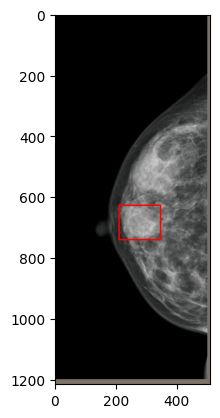

(1216, 512, 3)


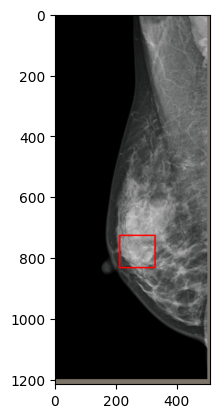

 23%|██████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                   | 338/1474 [02:45<10:50,  1.75it/s]

(1216, 512, 3)


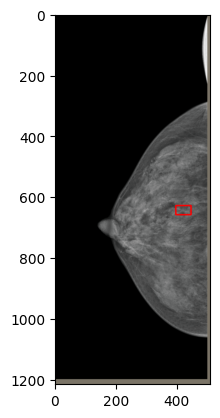

(1216, 512, 3)


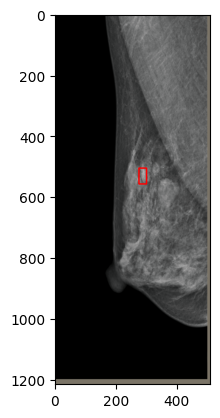

 23%|███████████████████████████████████████████████████████████████                                                                                                                                                                                                                   | 339/1474 [02:46<09:59,  1.89it/s]

(1216, 512, 3)


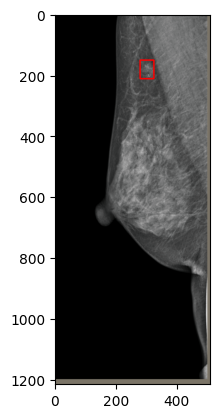

 23%|███████████████████████████████████████████████████████████████▏                                                                                                                                                                                                                  | 340/1474 [02:46<08:30,  2.22it/s]

(1216, 512, 3)


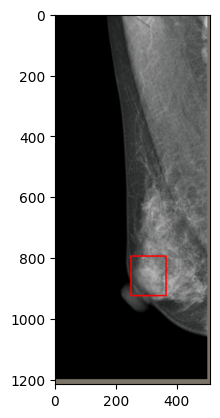

 23%|███████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                  | 343/1474 [02:47<08:43,  2.16it/s]

(1216, 512, 3)


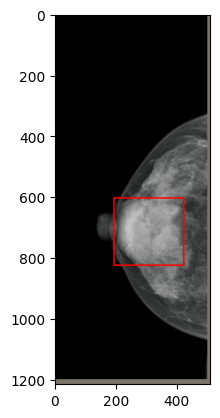

(1216, 512, 3)


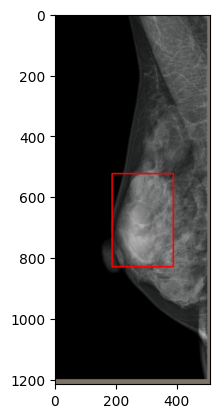

 23%|███████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                  | 344/1474 [02:48<08:30,  2.21it/s]

(1216, 512, 3)


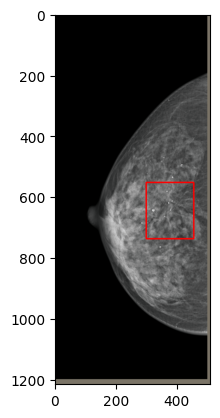

(1216, 512, 3)


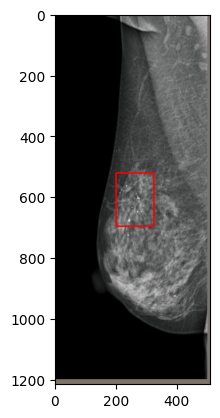

 23%|████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                                 | 346/1474 [02:49<10:05,  1.86it/s]

(1216, 512, 3)


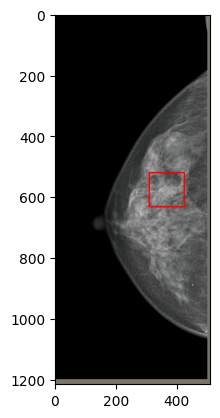

(1216, 512, 3)


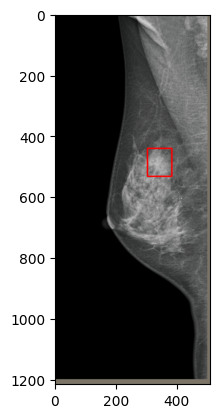

 24%|████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                 | 348/1474 [02:50<08:04,  2.32it/s]

(1216, 512, 3)


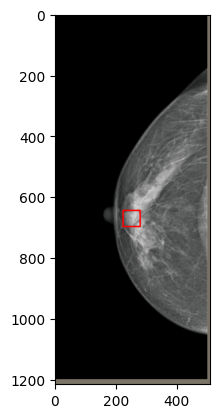

(1216, 512, 3)


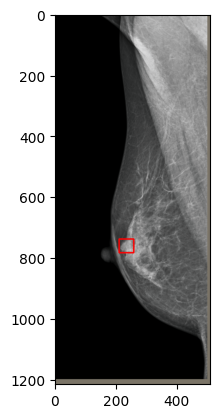

 24%|█████████████████████████████████████████████████████████████████                                                                                                                                                                                                                 | 350/1474 [02:51<08:40,  2.16it/s]

(1216, 512, 3)


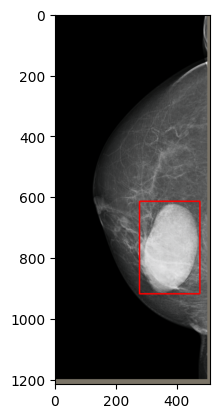

(1216, 512, 3)


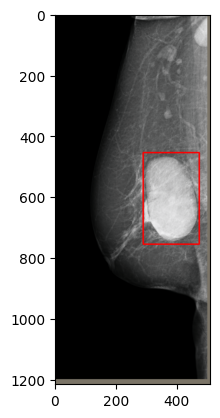

 24%|█████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                                | 352/1474 [02:51<07:18,  2.56it/s]

(1216, 512, 3)


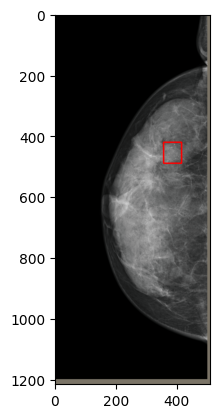

(1216, 512, 3)


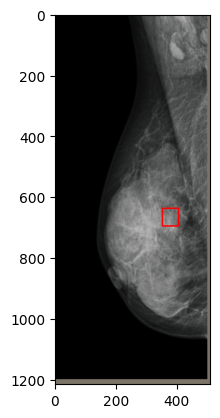

 24%|█████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                | 354/1474 [02:52<07:52,  2.37it/s]

(1216, 512, 3)


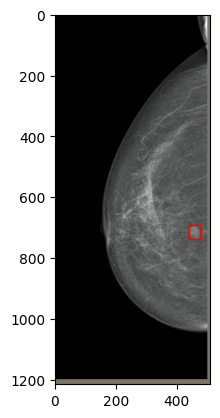

(1216, 512, 3)


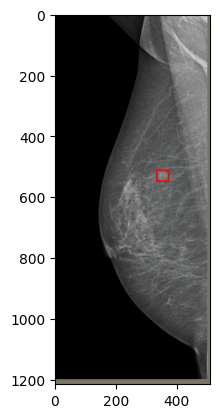

 24%|█████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                | 355/1474 [02:53<07:56,  2.35it/s]

(1216, 512, 3)


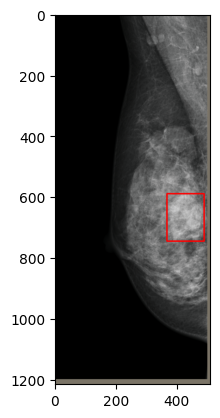

 24%|██████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                               | 358/1474 [02:54<07:41,  2.42it/s]

(1216, 512, 3)


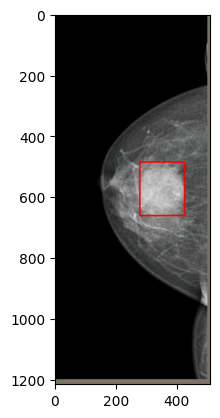

(1216, 512, 3)


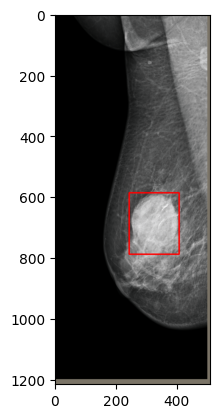

 24%|██████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                               | 360/1474 [02:54<06:40,  2.78it/s]

(1216, 512, 3)


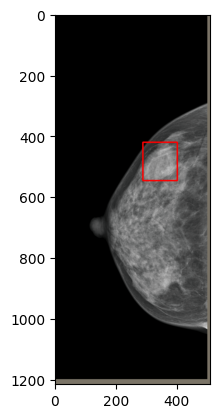

(1216, 512, 3)


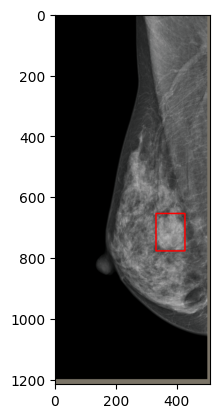

 25%|███████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                              | 362/1474 [02:55<08:14,  2.25it/s]

(1216, 512, 3)


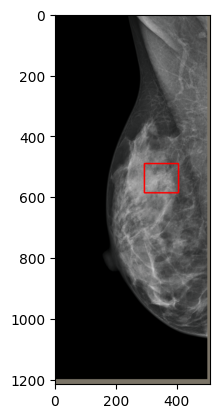

 25%|███████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                              | 365/1474 [02:56<05:22,  3.44it/s]

(1216, 512, 3)


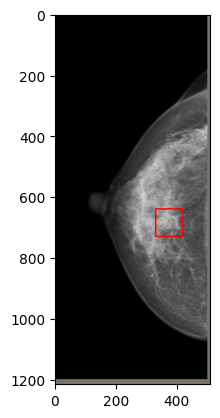

(1216, 512, 3)


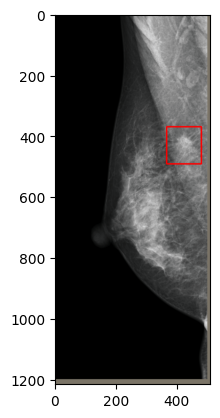

 25%|████████████████████████████████████████████████████████████████████                                                                                                                                                                                                              | 366/1474 [02:57<09:24,  1.96it/s]

(1216, 512, 3)


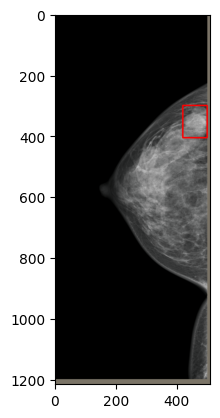

(1216, 512, 3)


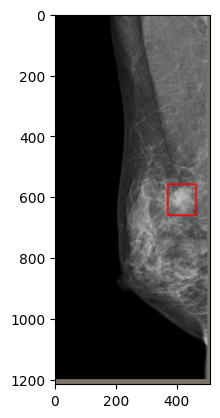

 25%|████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                             | 369/1474 [02:58<06:02,  3.05it/s]

(1216, 512, 3)


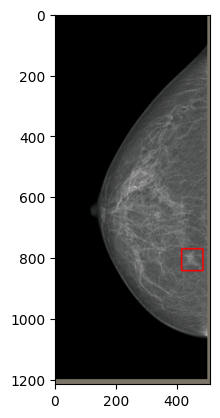

(1216, 512, 3)


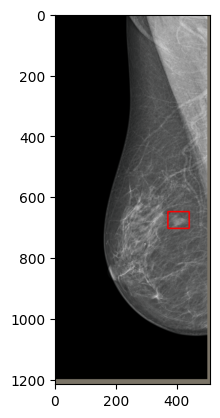

 25%|████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                             | 370/1474 [03:00<11:42,  1.57it/s]

(1216, 512, 3)


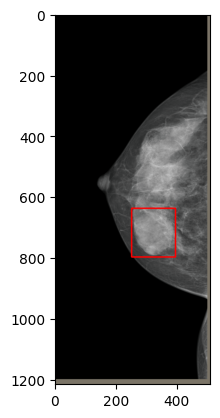

(1216, 512, 3)


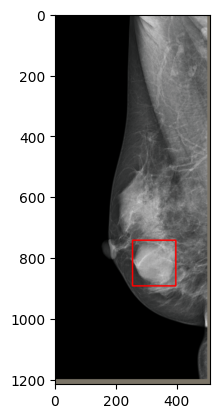

 25%|████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 371/1474 [03:00<10:46,  1.71it/s]

(1216, 512, 3)


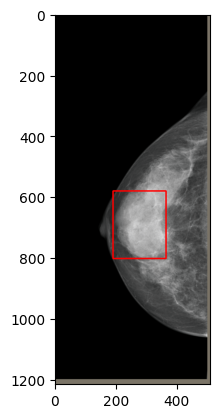

(1216, 512, 3)


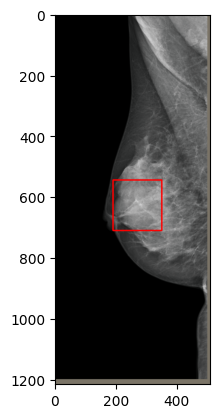

 25%|█████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                            | 372/1474 [03:00<09:54,  1.85it/s]

(1216, 512, 3)


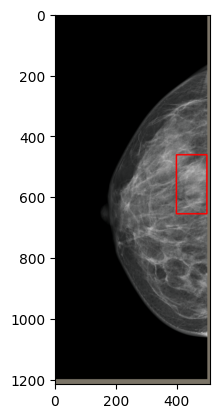

(1216, 512, 3)


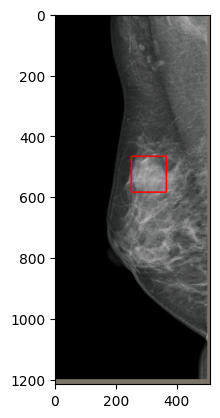

 25%|█████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 374/1474 [03:02<10:58,  1.67it/s]

(1216, 512, 3)


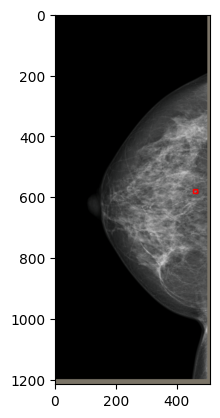

(1216, 512, 3)


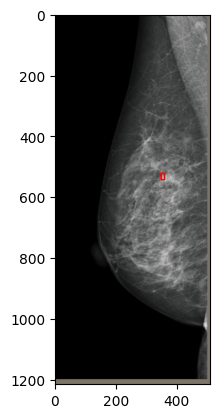

 26%|██████████████████████████████████████████████████████████████████████                                                                                                                                                                                                            | 377/1474 [03:02<06:46,  2.70it/s]

(1216, 512, 3)


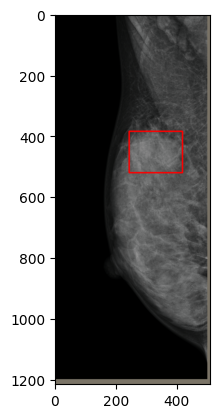

 26%|██████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                           | 378/1474 [03:04<10:31,  1.74it/s]

(1216, 512, 3)


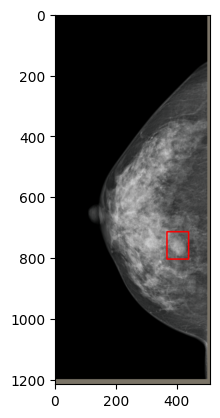

(1216, 512, 3)


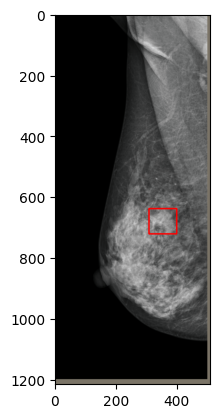

 26%|██████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                           | 380/1474 [03:04<08:07,  2.24it/s]

(1216, 512, 3)


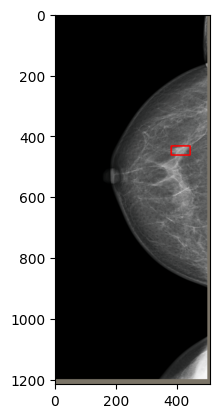

(1216, 512, 3)


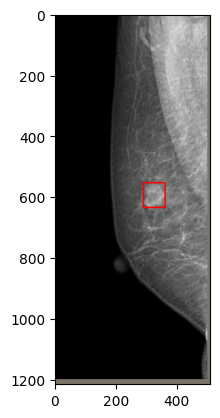

 26%|███████████████████████████████████████████████████████████████████████                                                                                                                                                                                                           | 382/1474 [03:06<10:27,  1.74it/s]

(1216, 512, 3)


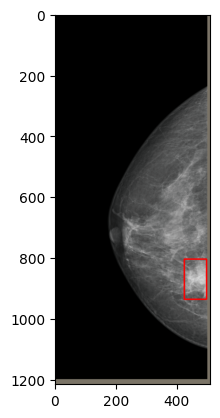

(1216, 512, 3)


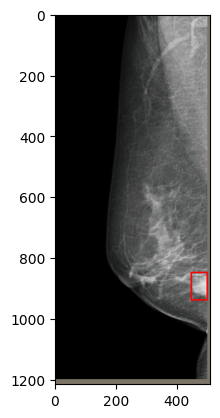

 26%|███████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                          | 384/1474 [03:06<07:51,  2.31it/s]

(1216, 512, 3)


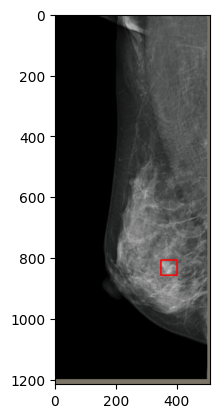

 26%|███████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                          | 386/1474 [03:08<10:35,  1.71it/s]

(1216, 512, 3)


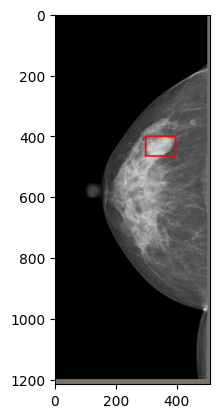

(1216, 512, 3)


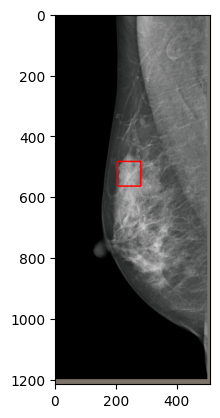

 26%|████████████████████████████████████████████████████████████████████████                                                                                                                                                                                                          | 388/1474 [03:08<08:24,  2.15it/s]

(1216, 512, 3)


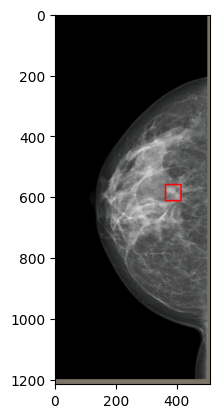

(1216, 512, 3)


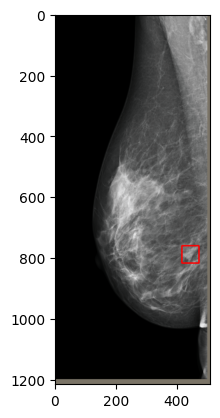

 26%|████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                         | 390/1474 [03:09<08:03,  2.24it/s]

(1216, 512, 3)


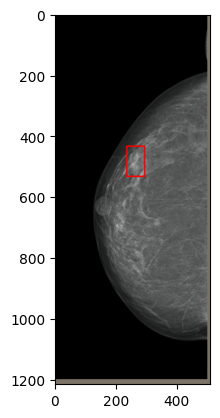

(1216, 512, 3)


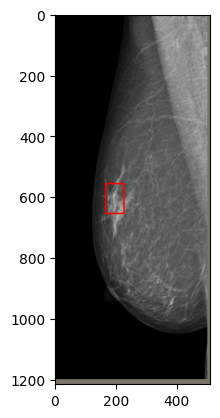

 27%|█████████████████████████████████████████████████████████████████████████                                                                                                                                                                                                         | 393/1474 [03:10<05:33,  3.25it/s]

(1216, 512, 3)


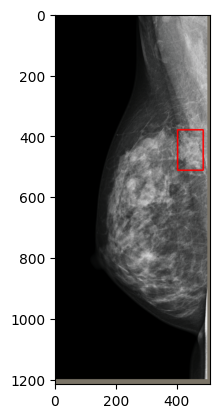

 27%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                        | 394/1474 [03:11<11:29,  1.57it/s]

(1216, 512, 3)


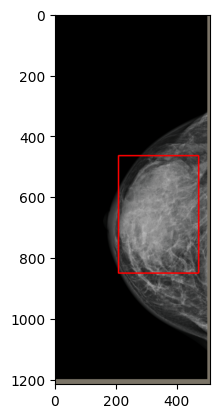

(1216, 512, 3)


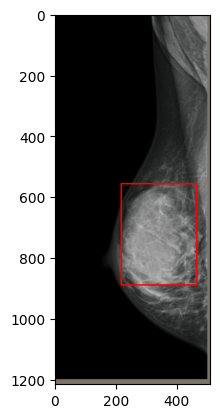

 27%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                        | 395/1474 [03:12<10:16,  1.75it/s]

(1216, 512, 3)


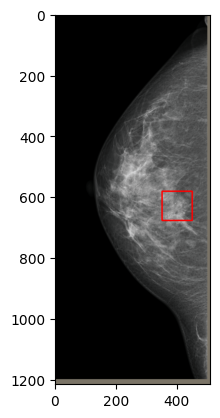

(1216, 512, 3)


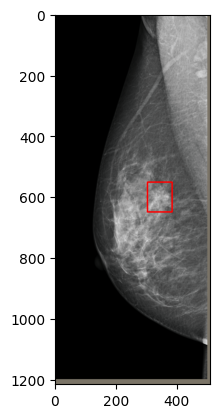

 27%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                        | 398/1474 [03:13<08:59,  1.99it/s]

(1216, 512, 3)


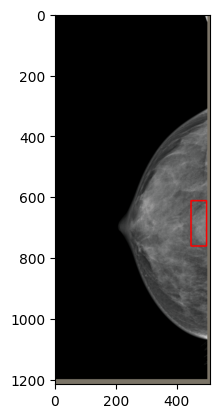

(1216, 512, 3)


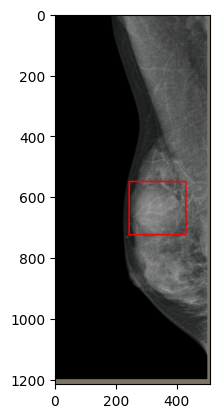

 27%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                       | 399/1474 [03:13<08:32,  2.10it/s]

(1216, 512, 3)


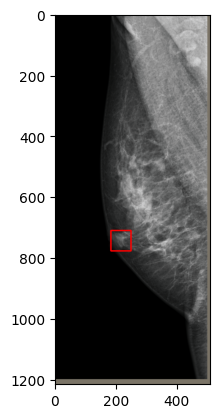

 27%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                       | 402/1474 [03:15<10:01,  1.78it/s]

(1216, 512, 3)


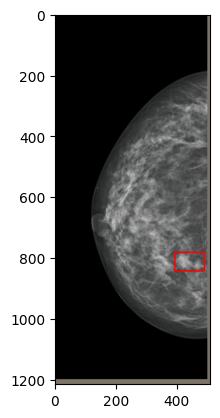

(1216, 512, 3)


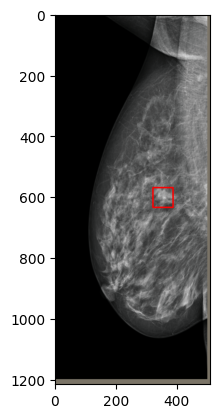

 27%|███████████████████████████████████████████████████████████████████████████                                                                                                                                                                                                       | 404/1474 [03:15<07:49,  2.28it/s]

(1216, 512, 3)


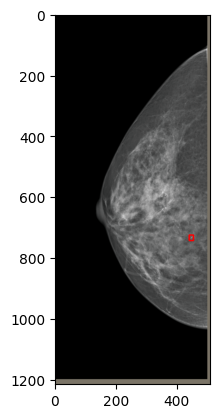

(1216, 512, 3)


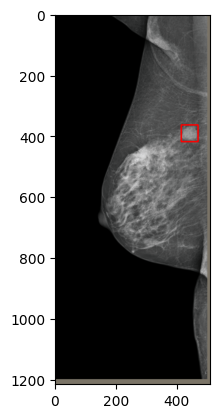

 28%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                      | 406/1474 [03:17<09:14,  1.93it/s]

(1216, 512, 3)


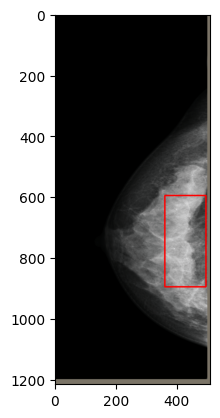

(1216, 512, 3)


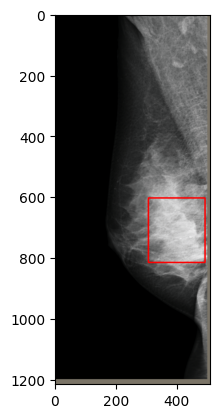

 28%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                      | 408/1474 [03:17<07:29,  2.37it/s]

(1216, 512, 3)


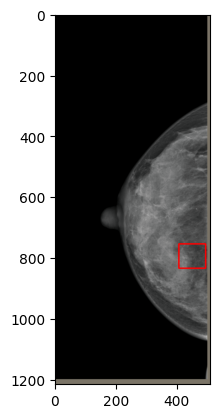

(1216, 512, 3)


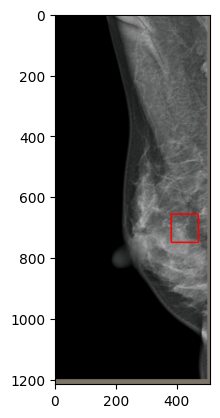

 28%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                     | 410/1474 [03:18<09:11,  1.93it/s]

(1216, 512, 3)


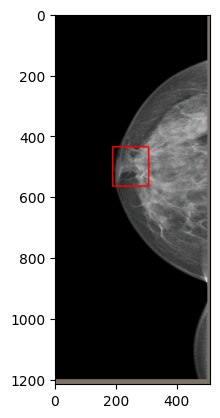

(1216, 512, 3)


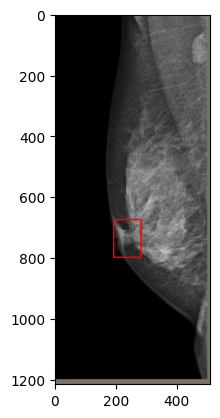

 28%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                     | 412/1474 [03:19<07:19,  2.42it/s]

(1216, 512, 3)


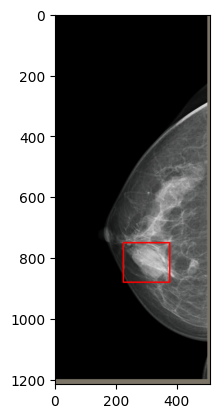

(1216, 512, 3)


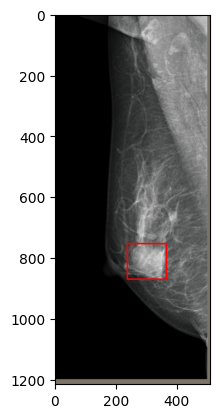

 28%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                     | 414/1474 [03:20<09:03,  1.95it/s]

(1216, 512, 3)


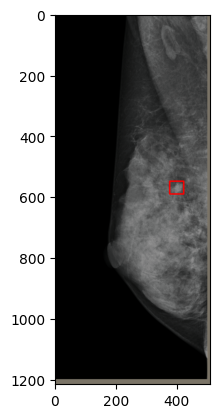

 28%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                    | 417/1474 [03:21<05:43,  3.08it/s]

(1216, 512, 3)


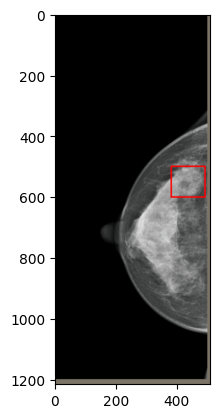

(1216, 512, 3)


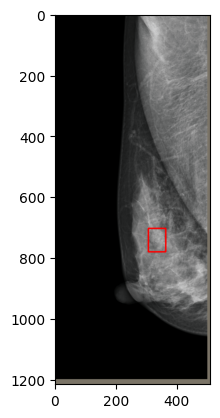

 28%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                    | 418/1474 [03:22<09:59,  1.76it/s]

(1216, 512, 3)


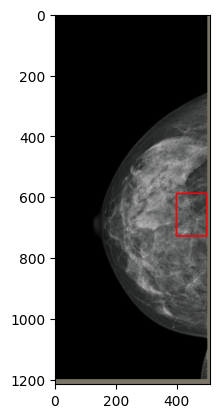

(1216, 512, 3)


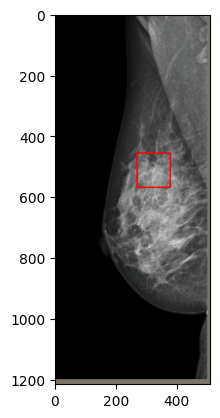

 29%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                   | 421/1474 [03:23<06:32,  2.68it/s]

(1216, 512, 3)


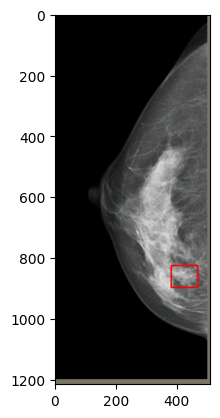

(1216, 512, 3)


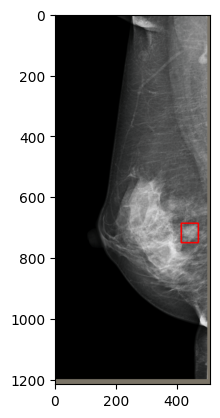

 29%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                   | 422/1474 [03:24<11:26,  1.53it/s]

(1216, 512, 3)


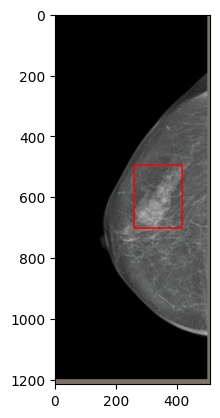

(1216, 512, 3)


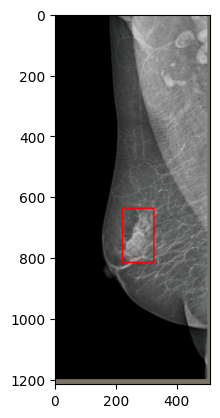

 29%|███████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                                   | 425/1474 [03:25<06:41,  2.62it/s]

(1216, 512, 3)


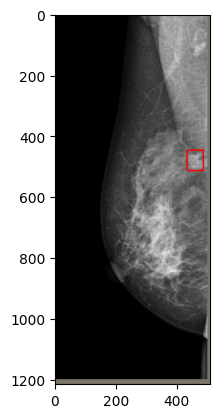

 29%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                  | 426/1474 [03:25<07:03,  2.48it/s]

(1216, 512, 3)


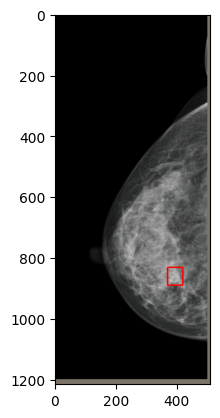

(1216, 512, 3)


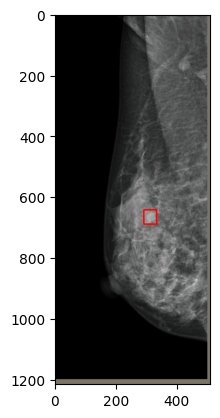

 29%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                  | 428/1474 [03:26<05:54,  2.95it/s]

(1216, 512, 3)


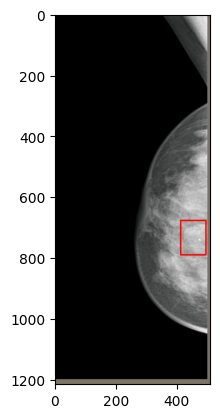

(1216, 512, 3)


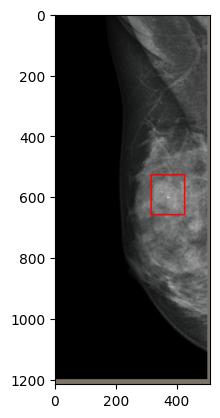

 29%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                  | 430/1474 [03:27<08:50,  1.97it/s]

(1216, 512, 3)


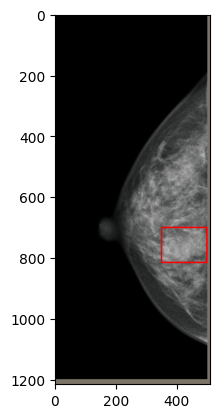

(1216, 512, 3)


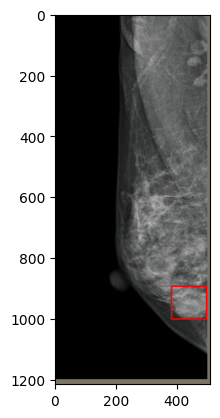

 29%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                 | 432/1474 [03:28<06:38,  2.61it/s]

(1216, 512, 3)


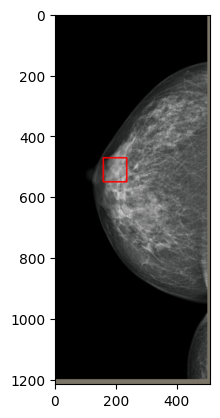

(1216, 512, 3)


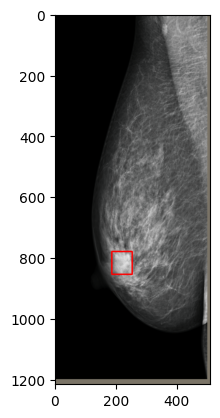

 29%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                 | 434/1474 [03:30<10:56,  1.58it/s]

(1216, 512, 3)


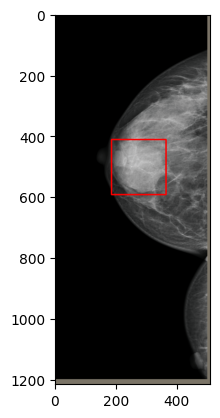

(1216, 512, 3)


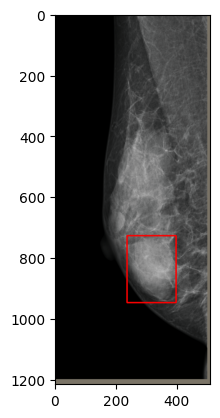

 30%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                | 437/1474 [03:30<06:26,  2.68it/s]

(1216, 512, 3)


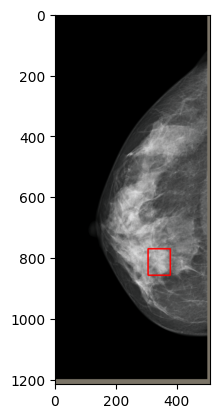

(1216, 512, 3)


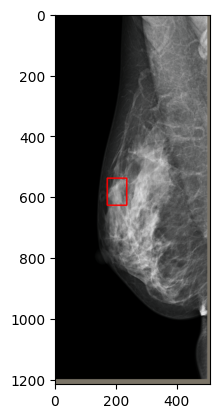

 30%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                | 438/1474 [03:32<09:57,  1.73it/s]

(1216, 512, 3)


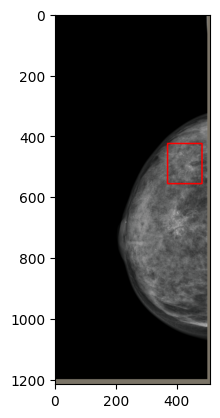

(1216, 512, 3)


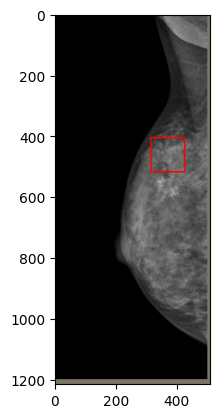

 30%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                | 440/1474 [03:32<08:13,  2.09it/s]

(1216, 512, 3)


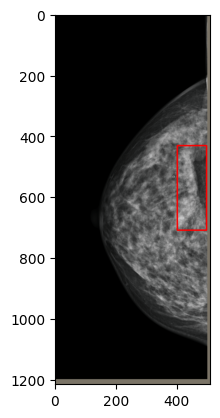

(1216, 512, 3)


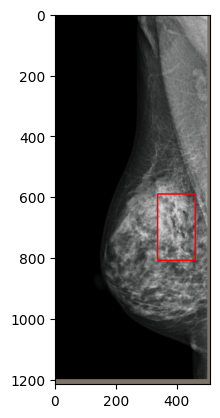

 30%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                               | 442/1474 [03:34<11:09,  1.54it/s]

(1216, 512, 3)


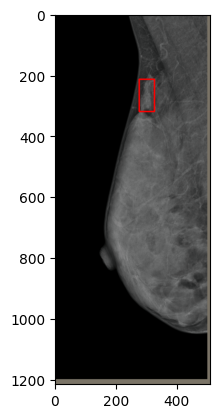

 30%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                               | 444/1474 [03:34<07:58,  2.15it/s]

(1216, 512, 3)


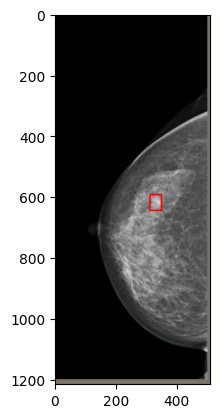

(1216, 512, 3)


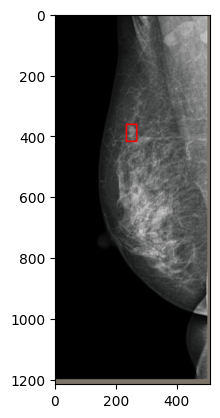

 30%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                               | 446/1474 [03:37<11:49,  1.45it/s]

(1216, 512, 3)


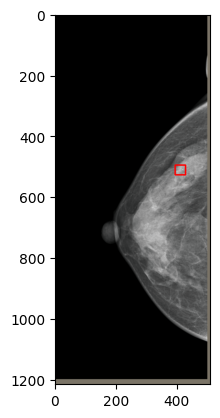

(1216, 512, 3)


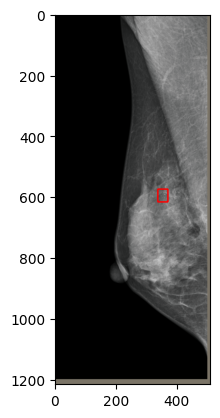

 30%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                              | 448/1474 [03:37<09:02,  1.89it/s]

(1216, 512, 3)


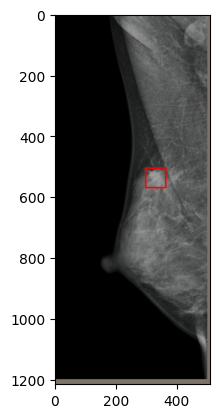

 31%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                              | 450/1474 [03:38<08:00,  2.13it/s]

(1216, 512, 3)


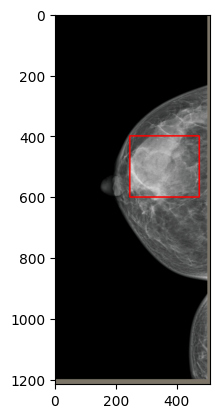

(1216, 512, 3)


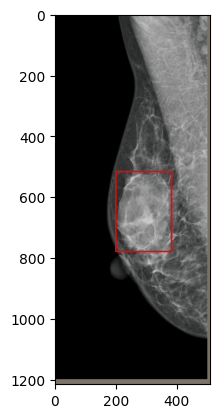

 31%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                              | 451/1474 [03:38<07:40,  2.22it/s]

(1216, 512, 3)


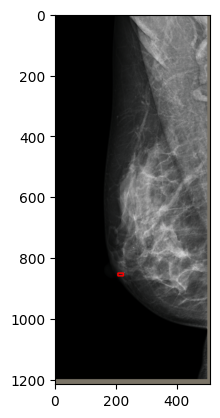

 31%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                             | 454/1474 [03:40<09:56,  1.71it/s]

(1216, 512, 3)


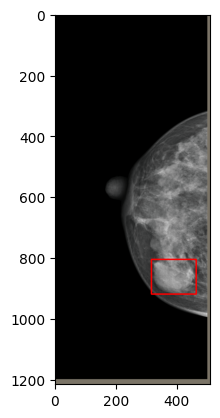

(1216, 512, 3)


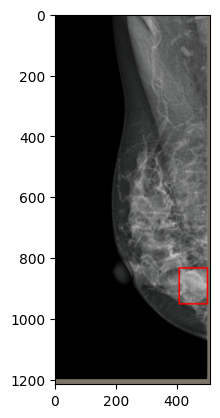

 31%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                             | 457/1474 [03:40<05:59,  2.83it/s]

(1216, 512, 3)


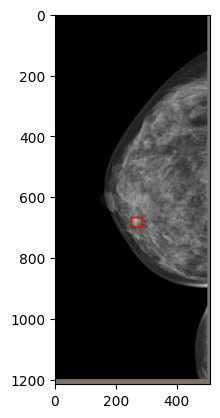

(1216, 512, 3)


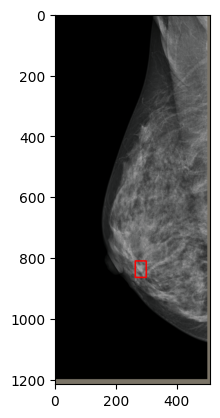

 31%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                            | 458/1474 [03:42<09:09,  1.85it/s]

(1216, 512, 3)


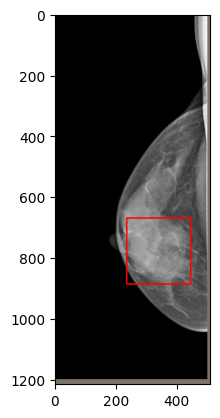

(1216, 512, 3)


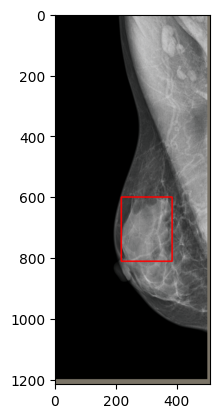

 31%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                            | 460/1474 [03:42<07:02,  2.40it/s]

(1216, 512, 3)


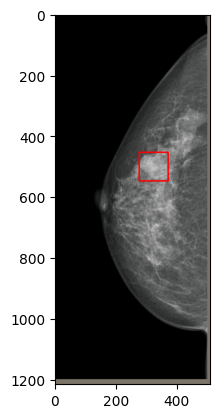

(1216, 512, 3)


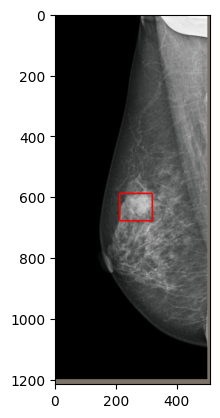

 31%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                            | 462/1474 [03:43<07:10,  2.35it/s]

(1216, 512, 3)


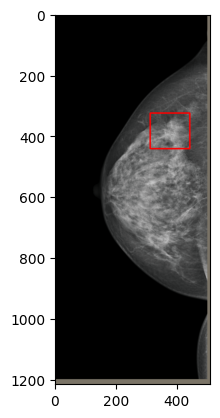

(1216, 512, 3)


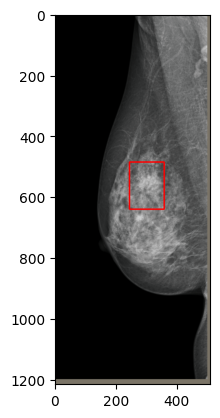

 31%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                           | 464/1474 [03:43<05:46,  2.91it/s]

(1216, 512, 3)


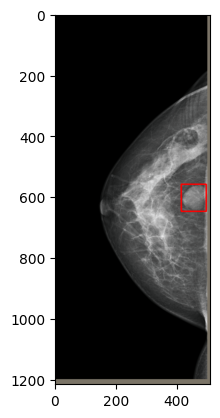

(1216, 512, 3)


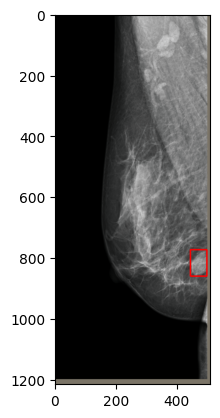

 32%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                           | 466/1474 [03:45<08:34,  1.96it/s]

(1216, 512, 3)


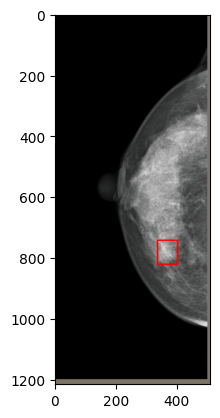

(1216, 512, 3)


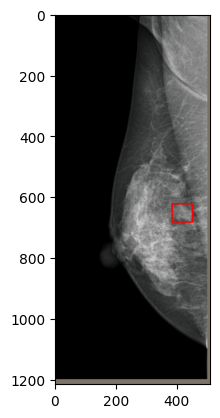

 32%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                          | 469/1474 [03:45<05:16,  3.17it/s]

(1216, 512, 3)


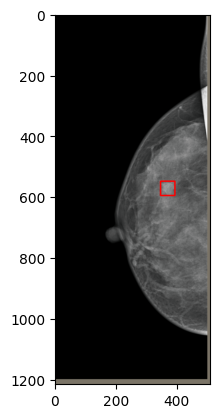

(1216, 512, 3)


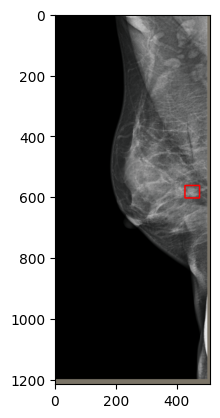

 32%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                          | 470/1474 [03:47<09:10,  1.83it/s]

(1216, 512, 3)


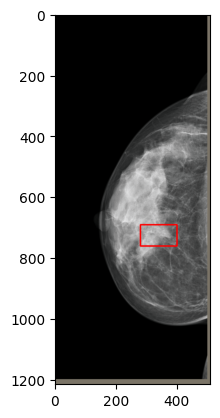

(1216, 512, 3)


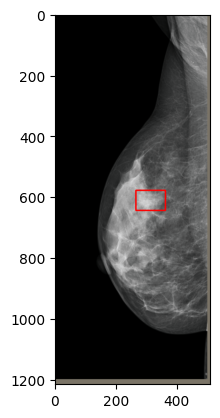

 32%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                          | 471/1474 [03:47<08:30,  1.97it/s]

(1216, 512, 3)


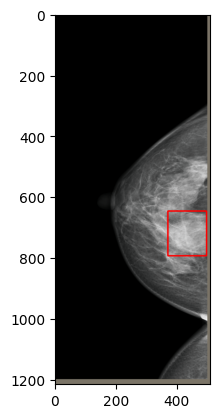

(1216, 512, 3)


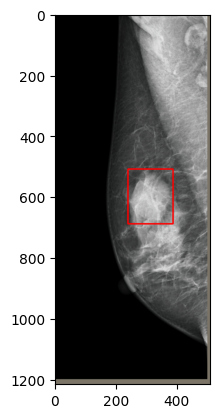

 32%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                         | 475/1474 [03:48<05:41,  2.92it/s]

(1216, 512, 3)


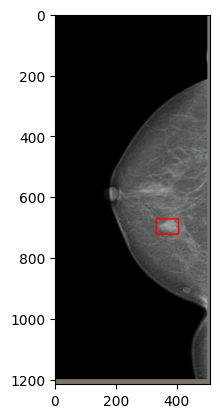

(1216, 512, 3)


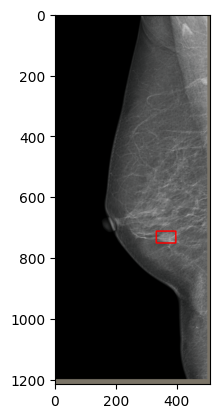

 32%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                         | 476/1474 [03:49<05:59,  2.78it/s]

(1216, 512, 3)


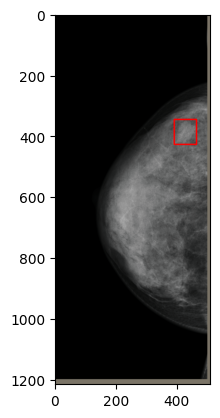

 32%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                         | 478/1474 [03:50<08:32,  1.94it/s]

(1216, 512, 3)


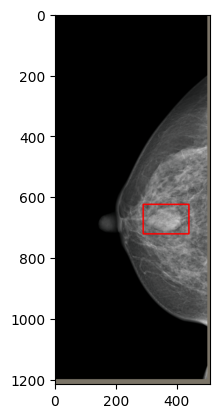

(1216, 512, 3)


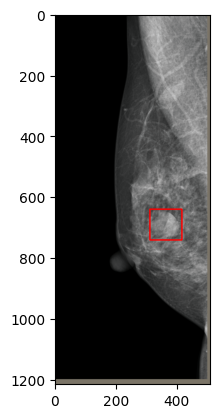

 33%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                        | 481/1474 [03:51<05:24,  3.06it/s]

(1216, 512, 3)


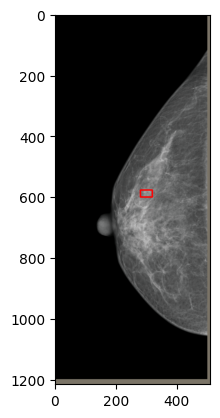

(1216, 512, 3)


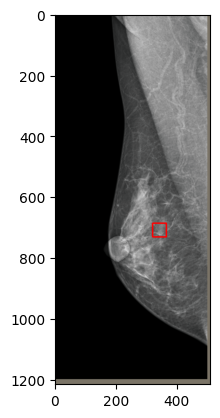

 33%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                        | 482/1474 [03:52<07:37,  2.17it/s]

(1216, 512, 3)


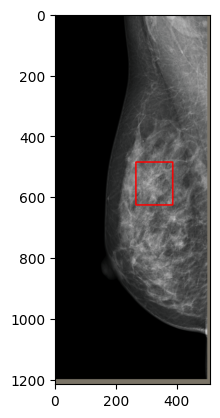

 33%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                        | 484/1474 [03:52<05:27,  3.02it/s]

(1216, 512, 3)


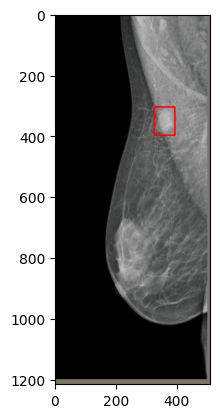

 33%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                       | 486/1474 [03:53<08:58,  1.83it/s]

(1216, 512, 3)


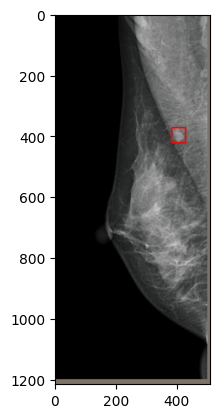

 33%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                       | 489/1474 [03:54<04:45,  3.45it/s]

(1216, 512, 3)


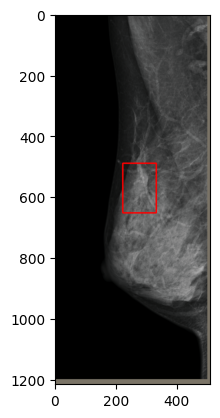

 33%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                       | 490/1474 [03:55<09:58,  1.64it/s]

(1216, 512, 3)


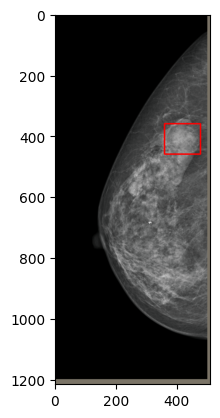

(1216, 512, 3)


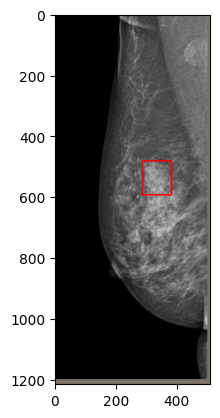

 33%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                      | 491/1474 [03:56<09:03,  1.81it/s]

(1216, 512, 3)


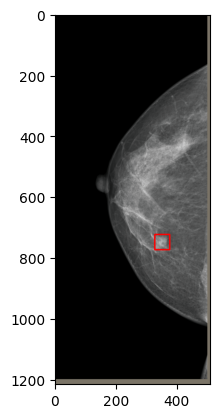

(1216, 512, 3)


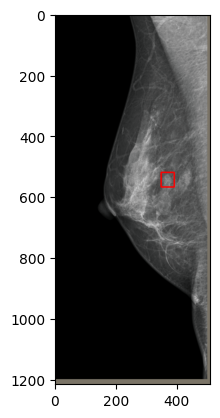

 34%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                      | 494/1474 [03:57<07:58,  2.05it/s]

(1216, 512, 3)


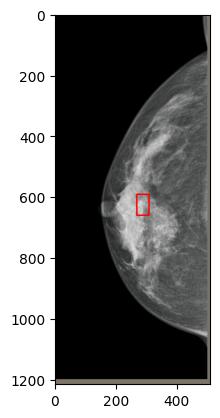

(1216, 512, 3)


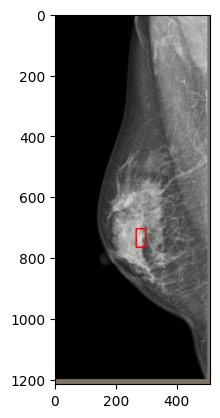

 34%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                     | 496/1474 [03:58<06:56,  2.35it/s]

(1216, 512, 3)


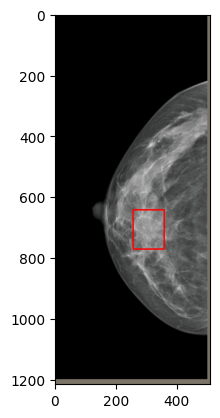

(1216, 512, 3)


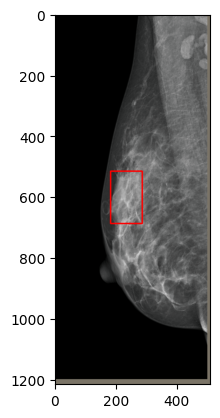

 34%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                     | 498/1474 [03:59<09:53,  1.65it/s]

(1216, 512, 3)


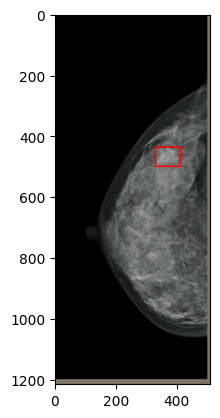

(1216, 512, 3)


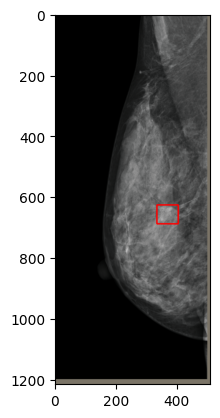

 34%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                     | 499/1474 [04:00<09:10,  1.77it/s]

(1216, 512, 3)


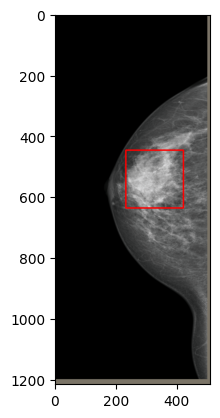

(1216, 512, 3)


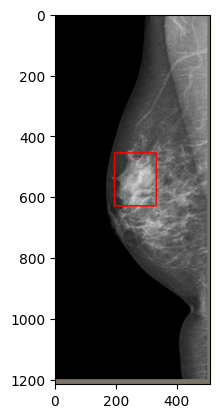

 34%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                    | 502/1474 [04:01<06:37,  2.45it/s]

(1216, 512, 3)


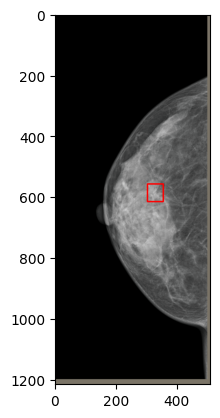

(1216, 512, 3)


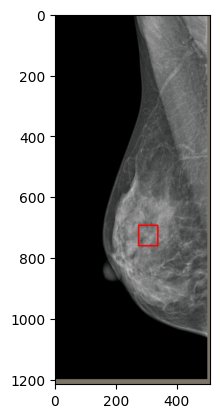

 34%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                    | 504/1474 [04:01<05:24,  2.99it/s]

(1216, 512, 3)


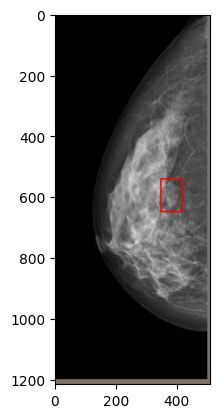

 34%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                    | 506/1474 [04:03<10:46,  1.50it/s]

(1216, 512, 3)


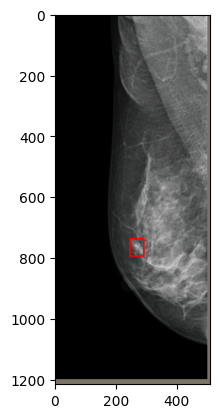

 35%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                   | 509/1474 [04:03<05:28,  2.93it/s]

(1216, 512, 3)


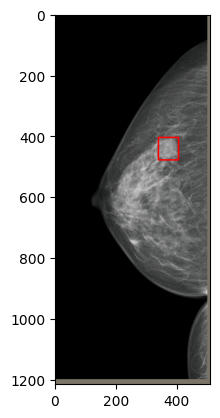

(1216, 512, 3)


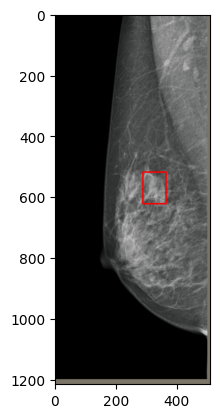

 35%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                   | 510/1474 [04:05<09:59,  1.61it/s]

(1216, 512, 3)


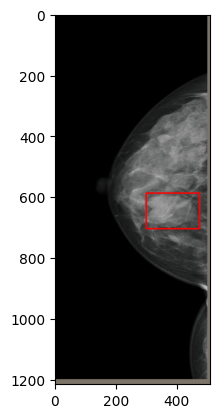

(1216, 512, 3)


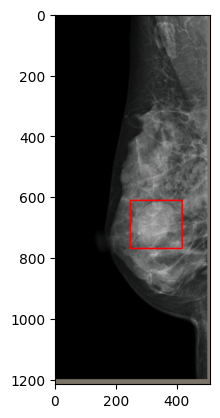

 35%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                  | 513/1474 [04:05<05:54,  2.71it/s]

(1216, 512, 3)


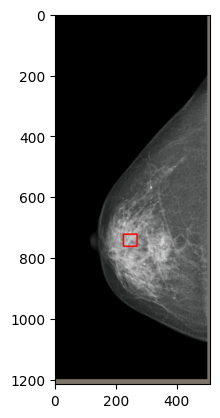

(1216, 512, 3)


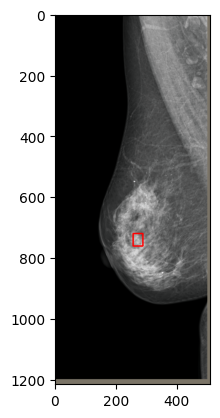

 35%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                  | 514/1474 [04:07<12:04,  1.33it/s]

(1216, 512, 3)


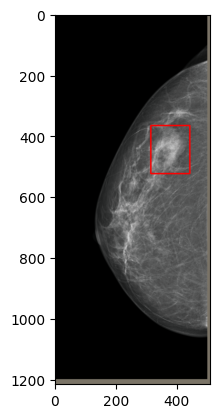

(1216, 512, 3)


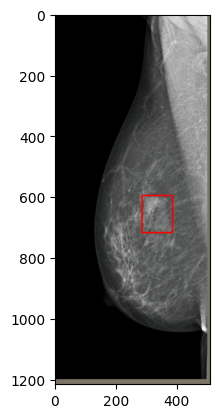

 35%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                  | 515/1474 [04:08<10:44,  1.49it/s]

(1216, 512, 3)


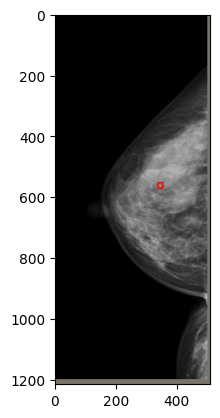

(1216, 512, 3)


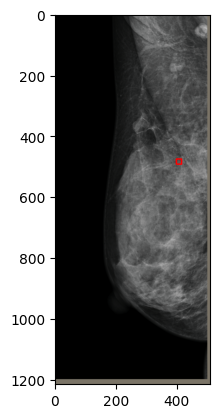

 35%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                 | 518/1474 [04:09<09:19,  1.71it/s]

(1216, 512, 3)


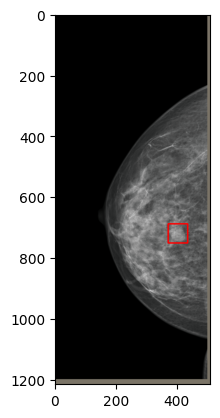

(1216, 512, 3)


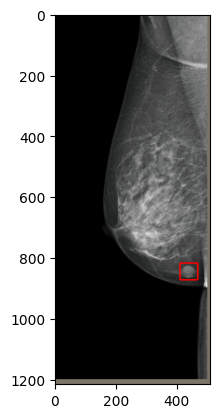

 35%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                 | 519/1474 [04:10<08:33,  1.86it/s]

(1216, 512, 3)


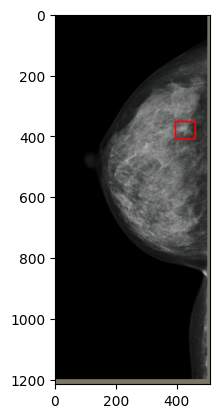

(1216, 512, 3)


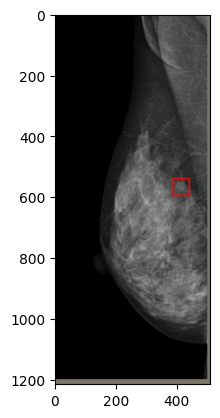

 35%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 522/1474 [04:11<08:50,  1.80it/s]

(1216, 512, 3)


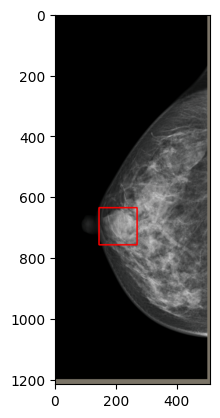

(1216, 512, 3)


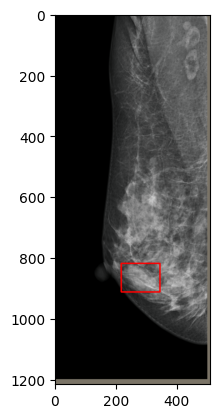

 36%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                | 524/1474 [04:12<06:50,  2.31it/s]

(1216, 512, 3)


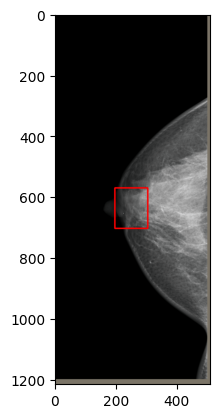

(1216, 512, 3)


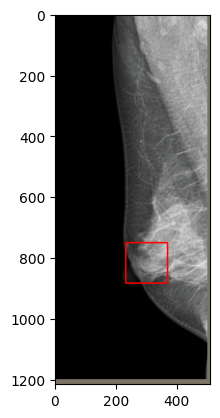

 36%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                | 526/1474 [04:13<07:20,  2.15it/s]

(1216, 512, 3)


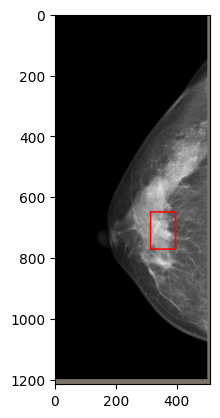

(1216, 512, 3)


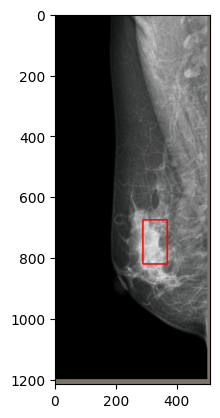

 36%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 528/1474 [04:13<05:50,  2.70it/s]

(1216, 512, 3)


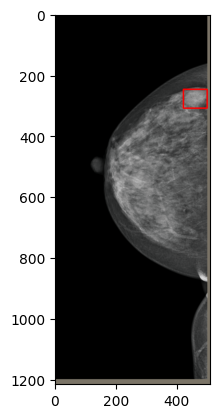

(1216, 512, 3)


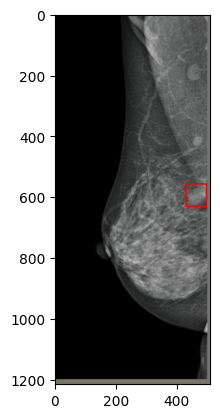

 36%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                               | 530/1474 [04:14<07:34,  2.08it/s]


(1216, 512, 3)


KeyboardInterrupt: 

In [6]:
n_threads = torch.get_num_threads()
# FIXME remove this and make paste_masks_in_image run on the GPU
torch.set_num_threads(1)
cpu_device = torch.device("cpu")
header = "Test:"
metric_logger = utils.MetricLogger(delimiter="  ")
counter=0
device=DEVICE
scaler=None
for images_CC, images_MLO, targets_CC, targets_MLO in tqdm(metric_logger.log_every(train_loader, 100, header), total=len(train_loader)):
        counter += 1
        images_CC = list(image_CC.to(device) for image_CC in images_CC)
        images_MLO = list(image_MLO.to(device) for image_MLO in images_MLO)
        #images = torch.stack(images)
        #print(images.shape)
        #images = images.to(device)
        targets_CC = [{k: v.to(device) for k, v in t.items()} for t in targets_CC]
        targets_MLO = [{k: v.to(device) for k, v in t.items()} for t in targets_MLO]
    

        with torch.cuda.amp.autocast(enabled=scaler is not None):
            loss_dict_CC, loss_dict_MLO = model(images_CC, images_MLO, targets_CC, targets_MLO)
            